In [1]:
suppressMessages(suppressWarnings(library(Seurat)))
suppressMessages(suppressWarnings(library(stringr)))
suppressMessages(suppressWarnings(library(dplyr)))

# Load data

In [3]:
dataobj <- readRDS("/data1/chenyx/Compitition/Tucker.rds")

# dimension reduction

PC_ 1 
Positive:  FGF12, MYBPC3, MYOM1, MLIP, RBM20, RYR2, CTNNA3, SGCD, SORBS2, TNNT2 
	   LDB3, CMYA5, CDH2, TRDN, NEBL, NEXN, SLC8A1, TTN, TECRL, AKAP6 
	   ACTN2, CACNB2, PALLD, MYO18B, MYOM2, PDLIM5, MYOZ2, ERBB4, THSD4, ESRRG 
Negative:  EBF1, NEGR1, MAML2, PID1, DCN, ACSM3, GSN, SPARCL1, MGST1, ABCA6 
	   SMIM6, PLA2G5, PLXDC2, DCLK1, AKT3, MECOM, ABCA8, ABCA9, ADGRB3, FBN1 
	   TSHZ2, GLIS3, TACC1, TFPI, CFD, KAZN, EBF2, BICC1, VCAN, UNC5C 
PC_ 2 
Positive:  PDE7A, PDZRN3, CACNB2, TMEM178B, ESRRG, PLCXD3, RBFOX1, PDE3A, PLCL1, CDIN1 
	   AKAP6, ANK2, TTN-AS1, IL1RAPL1, RCAN2, PCDH7, SGCD, PDE1C, TACC2, FHIT 
	   CHRM2, ACACB, THSD4, XIST, LARGE1, RBM20, MLIP, PDZD2, LTBP1, FHL2 
Negative:  MT-CO3, MT-ATP6, MT-CYB, MT-ND1, MT-ND4, MT-CO1, MT-CO2, MT-ND2, MT-ND3, CRYAB 
	   TCAP, NDUFA4, UQCRB, COX7C, RPLP1, COX4I1, GAPDH, ACTC1, COX5B, PTGDS 
	   COX6A2, CKM, MYL12A, DES, ALDOA, FTH1, B2M, TPT1, COX6C, ATP5MC3 
PC_ 3 
Positive:  NEGR1, DCN, PID1, MGST1, ACSM3, ABCA6, ABCA8, CFD,

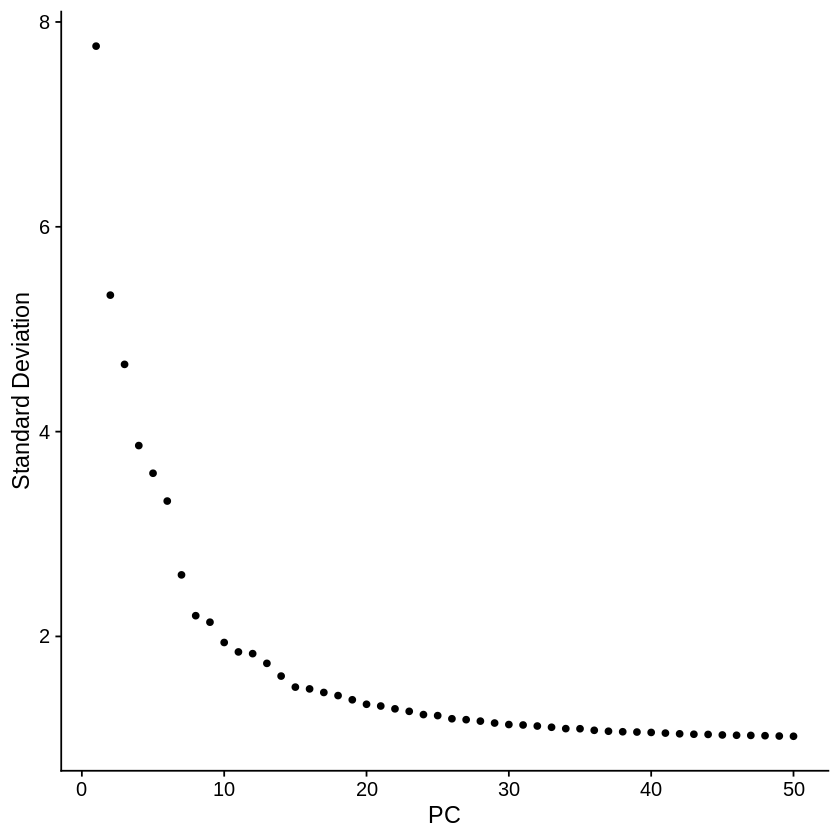

In [4]:
dataobj <- RunPCA(dataobj)
ElbowPlot(dataobj,ndims=50) 

In [5]:
pcDim = 30

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:58:03 UMAP embedding parameters a = 0.9922 b = 1.112

14:58:04 Read 262003 rows and found 30 numeric columns

14:58:04 Using Annoy for neighbor search, n_neighbors = 30

14:58:04 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:58:29 Writing NN index file to temp file /tmp/RtmpAbE7Wn/file16bc6f56264136

14:58:30 Searching Annoy index using 1 thread, search_k = 3000

15:00:04 Annoy recall = 100%

15:00:05 Commencing smooth kNN distance calibration using 1 thread

15:00:16 Initializing

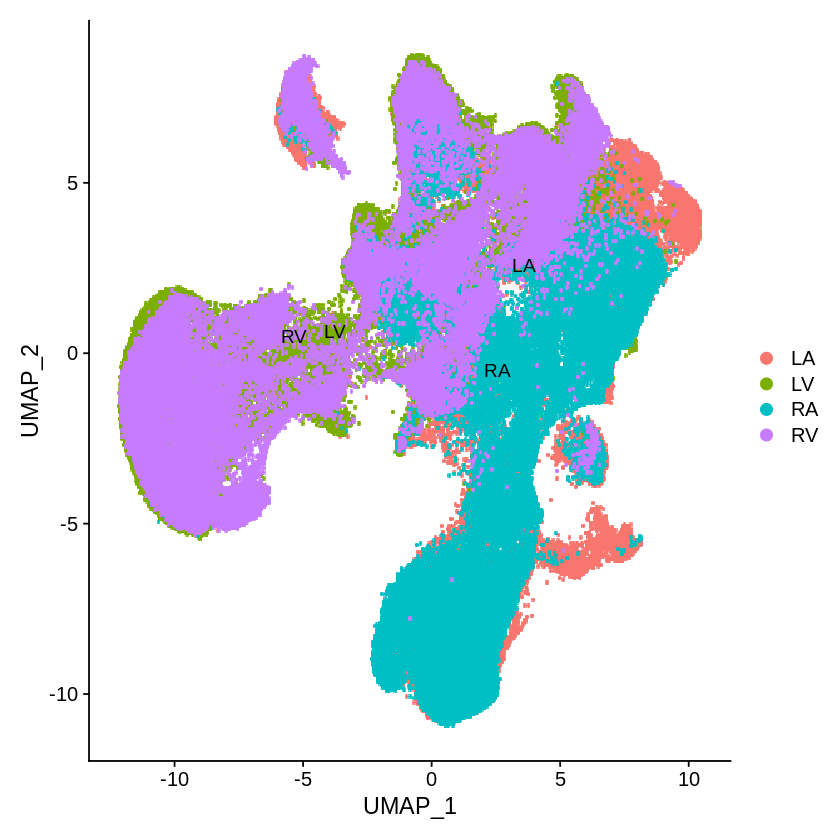

In [6]:
dataobj <- RunUMAP(dataobj, dims = 1:pcDim)
DimPlot(dataobj, reduction = "umap", label = TRUE, pt.size=1)

# Clustering

In [10]:
# Cluster the cells
dataobj <- FindNeighbors(dataobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
dataobj <- FindClusters(dataobj, resolution = 0.5, n.start = 10)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 262003
Number of edges: 8268482

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9345
Number of communities: 31
Elapsed time: 124 seconds


5 singletons identified. 26 final clusters.



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



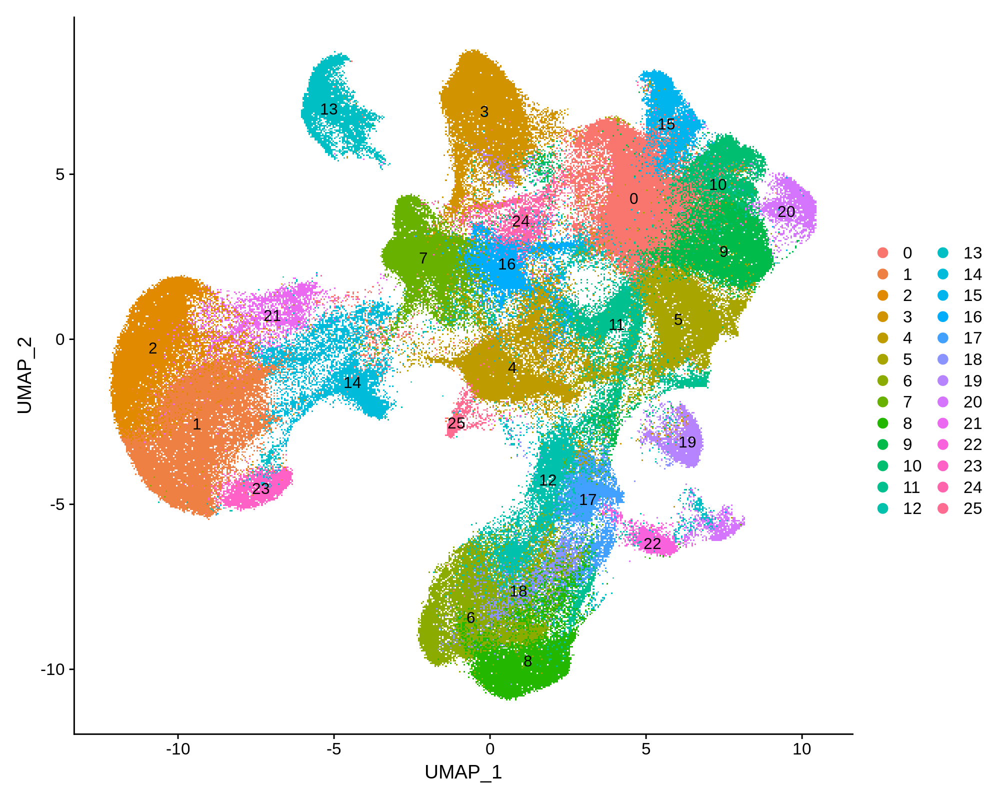

In [34]:
options(repr.plot.width=10, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



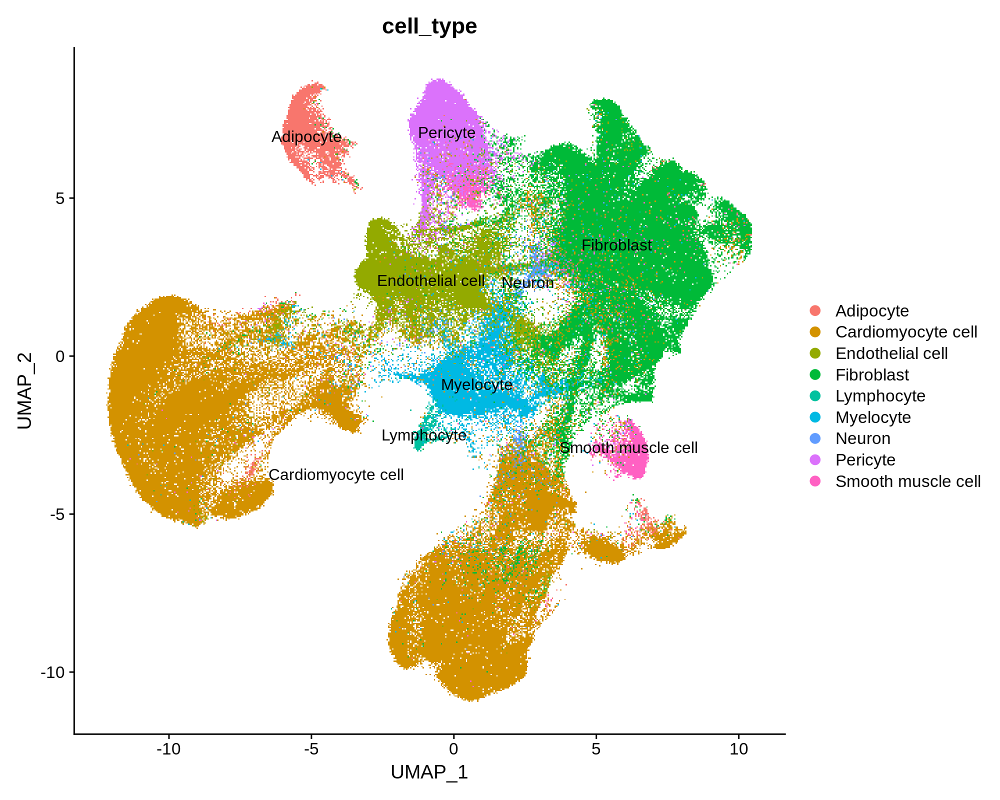

In [14]:
options(repr.plot.width=10, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T,group.by = "cell_type")

# Annoation

### Fibroblast

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



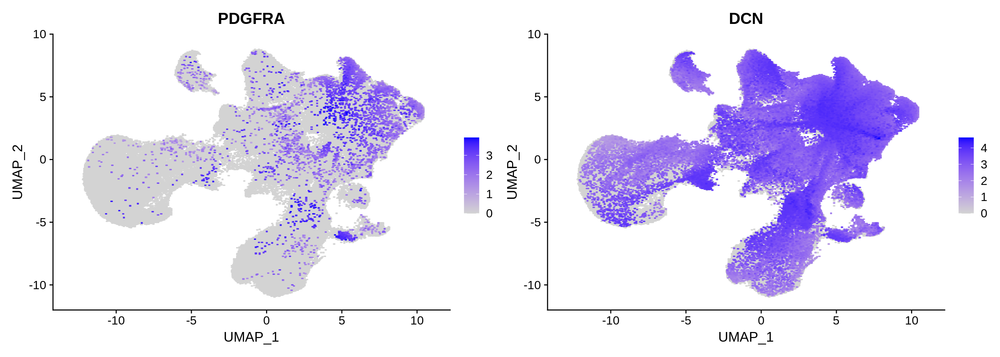

In [12]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1
FeaturePlot(dataobj,features = c("PDGFRA","DCN"),pt.size = pt.size,order = T,ncol=2)

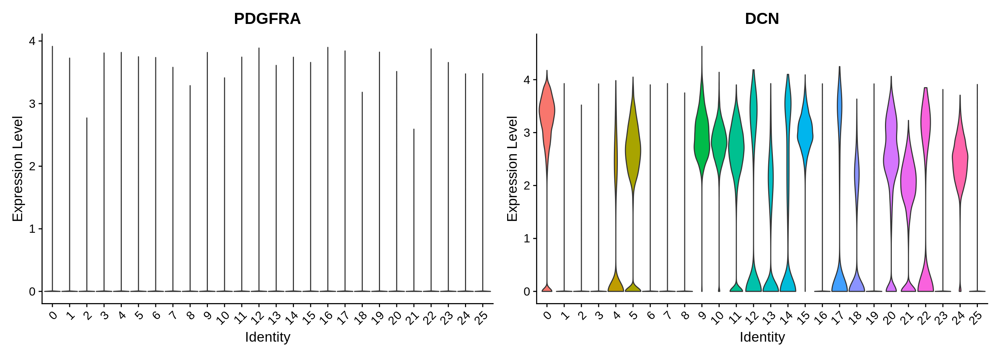

In [13]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

VlnPlot(dataobj,features = c("PDGFRA","DCN"),pt.size = 0,ncol=2)

In [35]:
dataobj <- RenameIdents(object = dataobj,'0' = 'Fibroblast','5' = 'Fibroblast','9' = 'Fibroblast','10' = 'Fibroblast','11' = 'Fibroblast','15' = 'Fibroblast','20' = 'Fibroblast','24' = 'Fibroblast')

### Cardiomyocyte cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



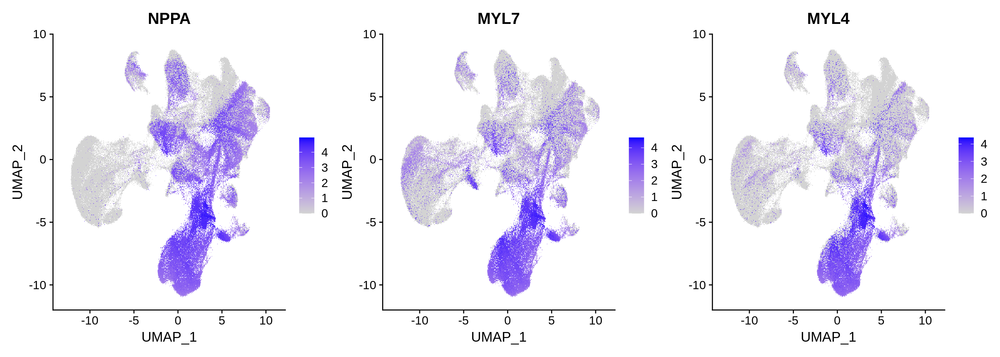

In [18]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

FeaturePlot(dataobj,features = c("NPPA","MYL7","MYL4"),pt.size = 0.1,order = T,ncol=3)

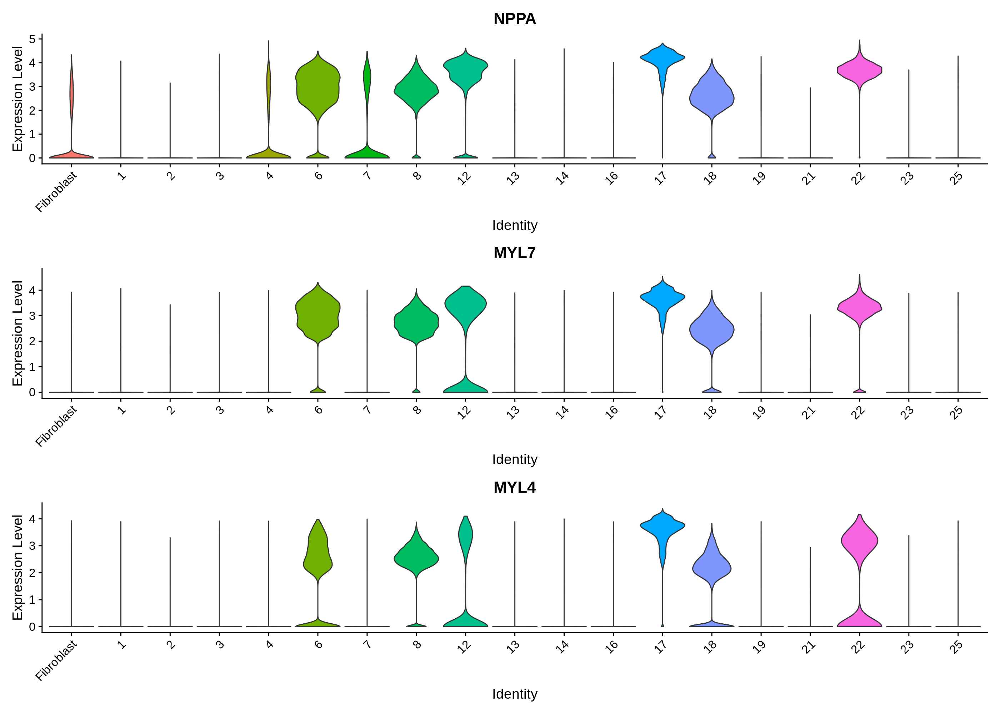

In [19]:
options(repr.plot.width=14, repr.plot.height=10, repr.plot.res = 200)

VlnPlot(dataobj,features = c("NPPA","MYL7","MYL4"),pt.size = 0,ncol=1)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



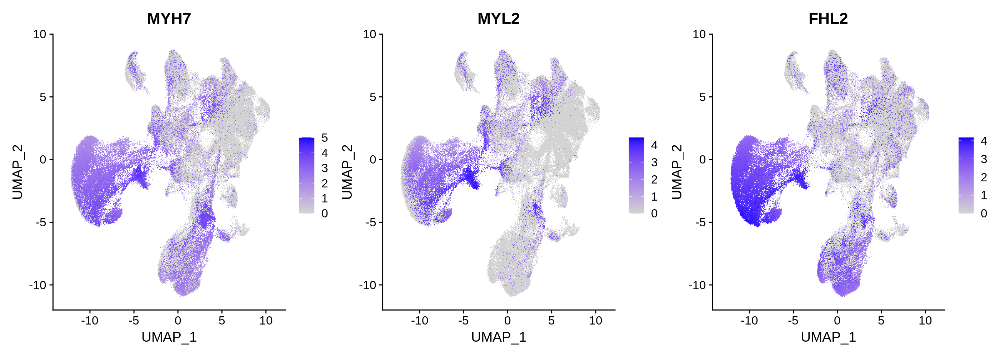

In [20]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

FeaturePlot(dataobj,features = c("MYH7","MYL2","FHL2"),pt.size = 0.1,order = T,ncol=3)

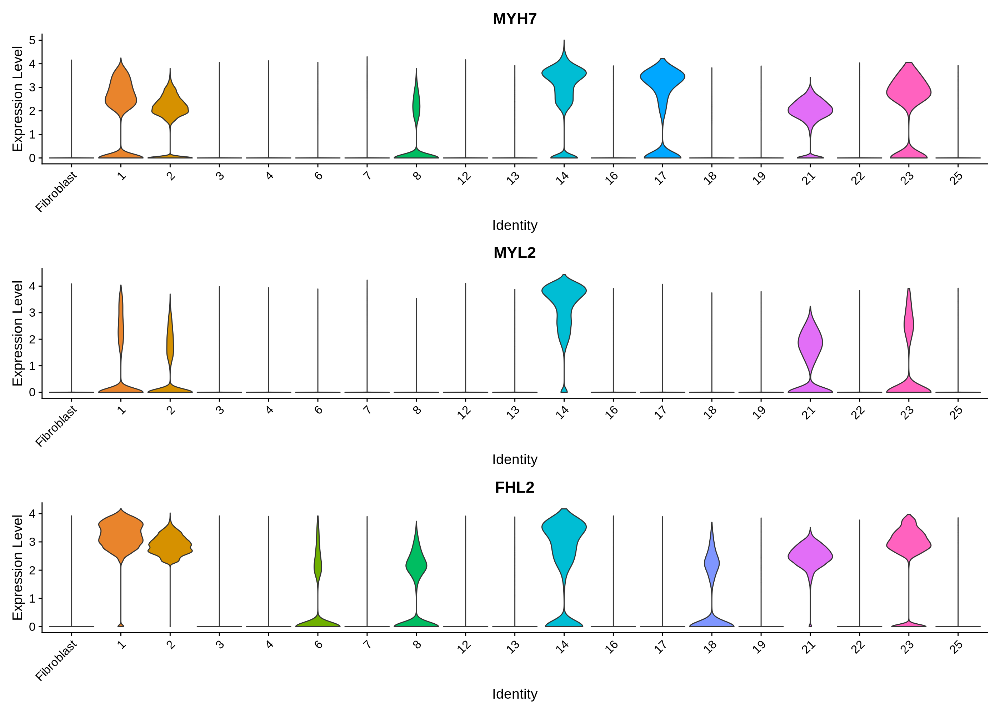

In [21]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MYH7","MYL2","FHL2"),pt.size = 0,ncol=1)

In [36]:
dataobj <- RenameIdents(object = dataobj,'1' = 'Cardiomyocyte cell', '2' = 'Cardiomyocyte cell','21' = 'Cardiomyocyte cell','23' = 'Cardiomyocyte cell','14' = 'Cardiomyocyte cell')

In [37]:
dataobj <- RenameIdents(object = dataobj,'6' = 'Cardiomyocyte cell', '8' = 'Cardiomyocyte cell','12' = 'Cardiomyocyte cell','17' = 'Cardiomyocyte cell','18' = 'Cardiomyocyte cell','22' = 'Cardiomyocyte cell')

### SMC

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



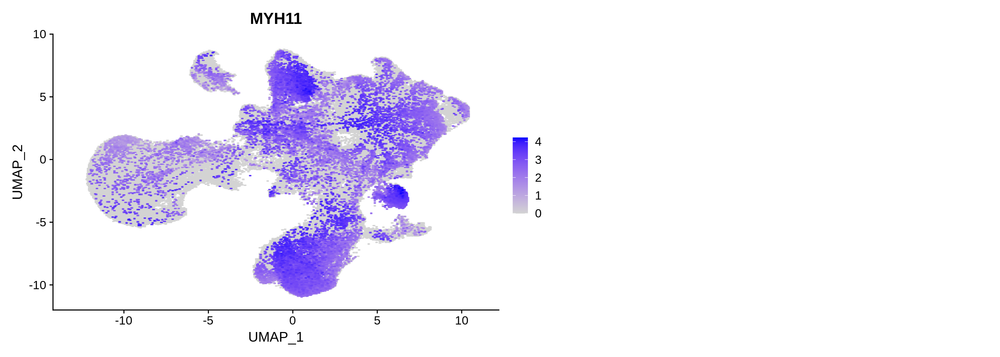

In [24]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MYH11"),pt.size = pt.size,order = T,ncol=2)

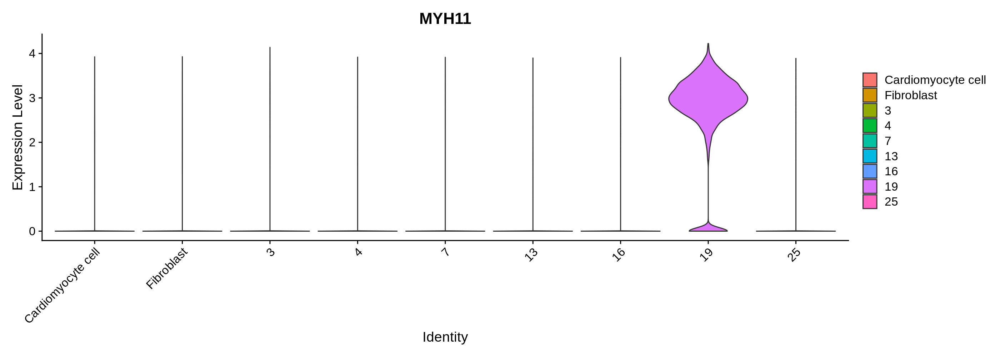

In [25]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MYH11"),pt.size = 0,ncol=1)

In [38]:
dataobj <- RenameIdents(object = dataobj,'19' = 'Smooth muscle cell')

### Pericyte

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



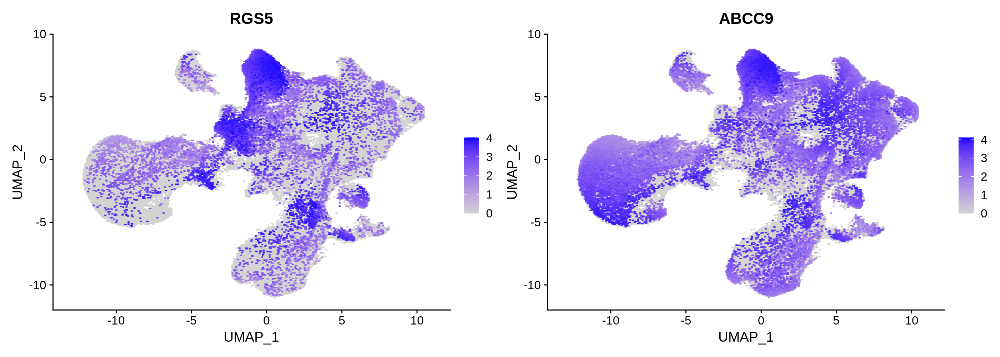

In [27]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("RGS5","ABCC9"),pt.size = pt.size,order = T,ncol=2)

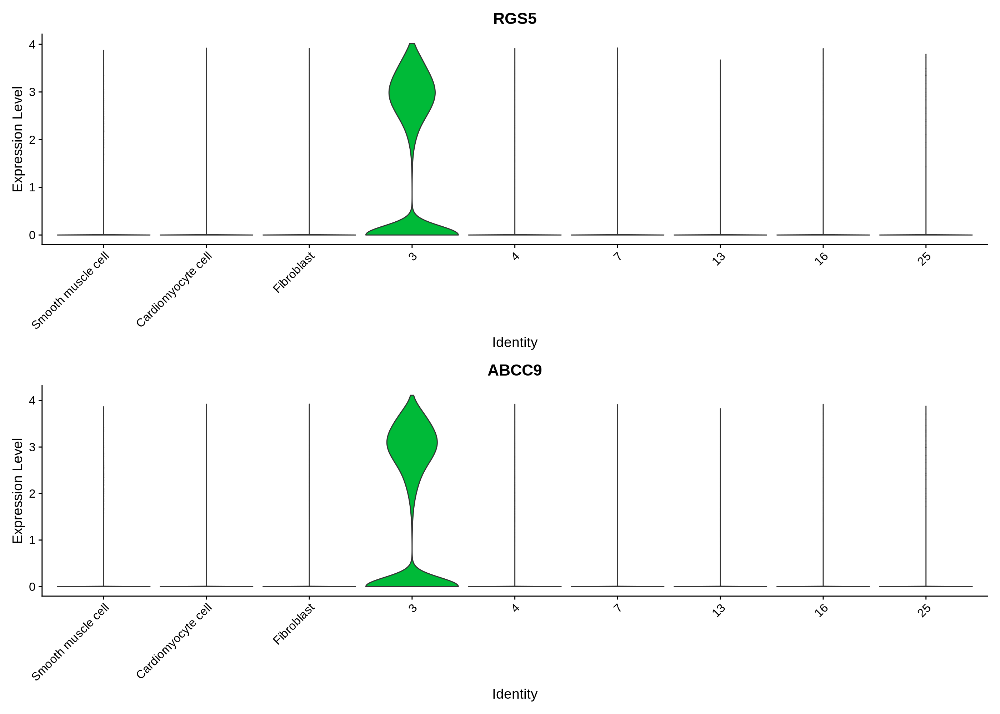

In [28]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("RGS5","ABCC9"),pt.size = 0,ncol=1)

In [39]:
dataobj <- RenameIdents(object = dataobj,'3' = 'Pericyte')

### Mesothelial cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



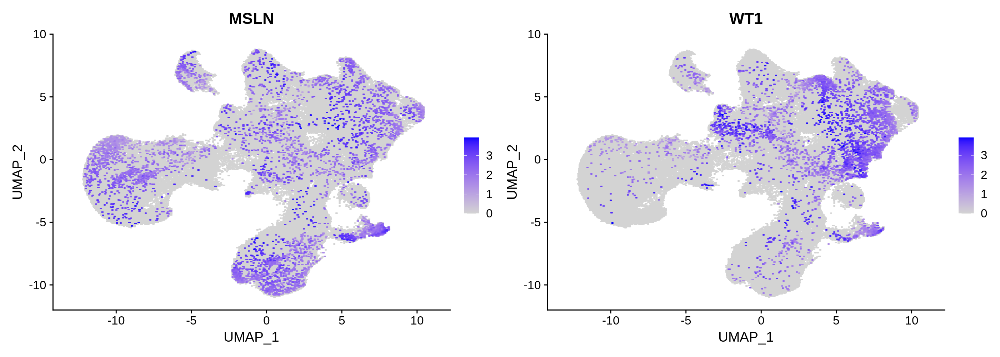

In [30]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MSLN","WT1"),pt.size = pt.size,order = T,ncol=2)

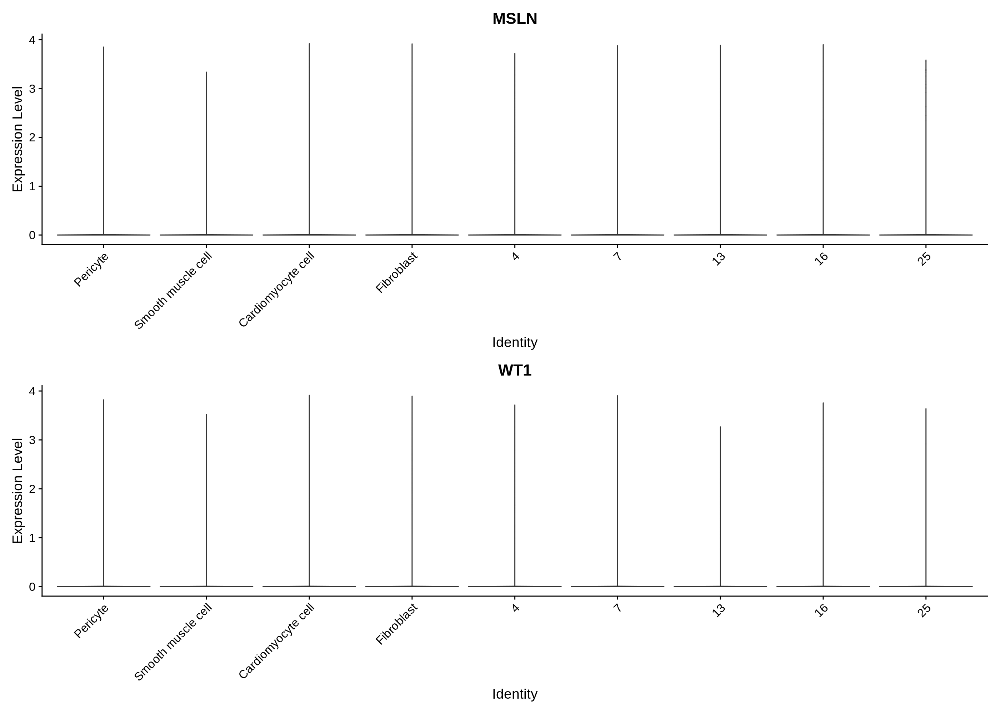

In [31]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MSLN","WT1"),pt.size = 0,ncol=1)

### Endothelial cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



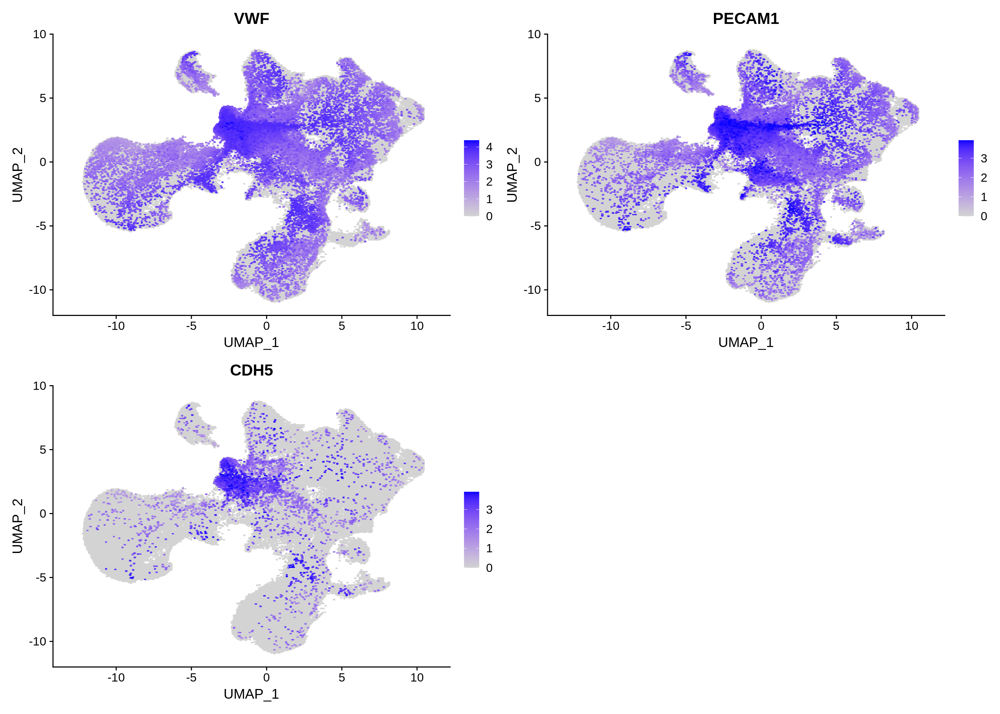

In [40]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("VWF","PECAM1","CDH5"),pt.size = pt.size,order = T,ncol=2)

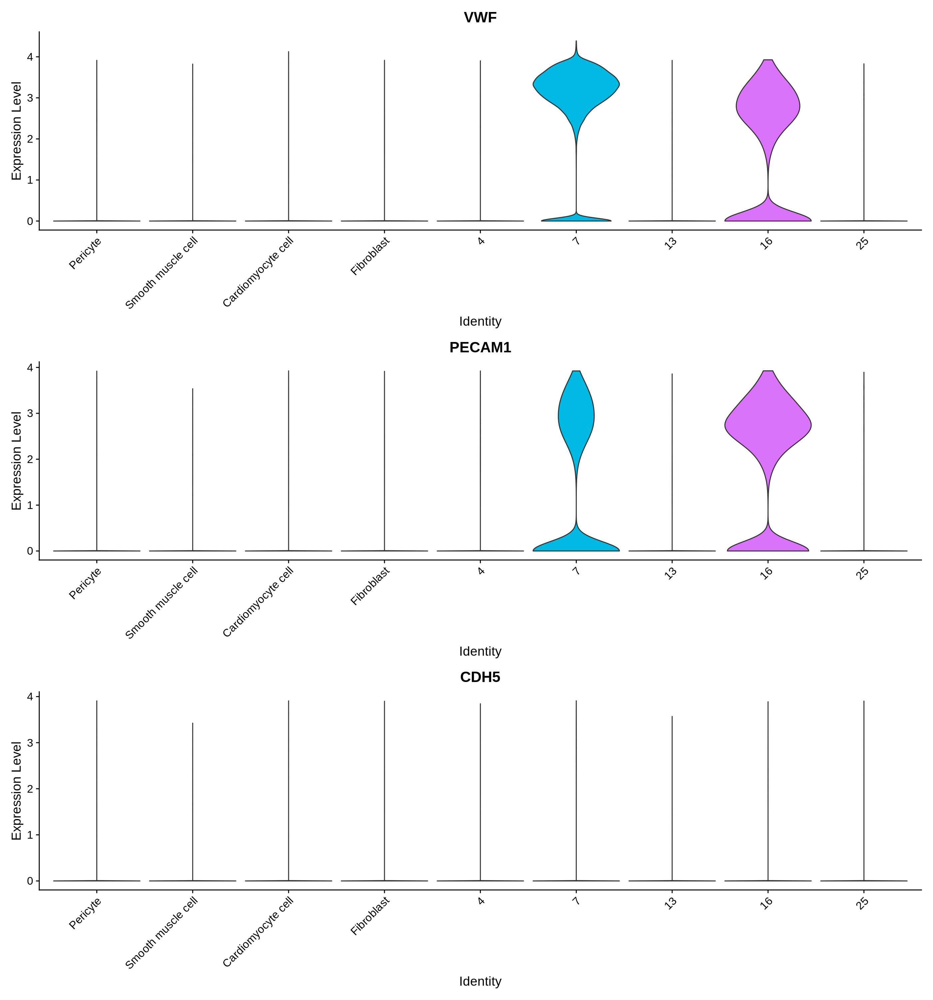

In [41]:
options(repr.plot.width=14, repr.plot.height=5*3, repr.plot.res = 200)

VlnPlot(dataobj,features = c("VWF","PECAM1","CDH5"),pt.size = 0,ncol=1)

In [42]:
dataobj <- RenameIdents(object = dataobj,'7' = 'Endothelial cell','16' = 'Endothelial cell')

### Neuron

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



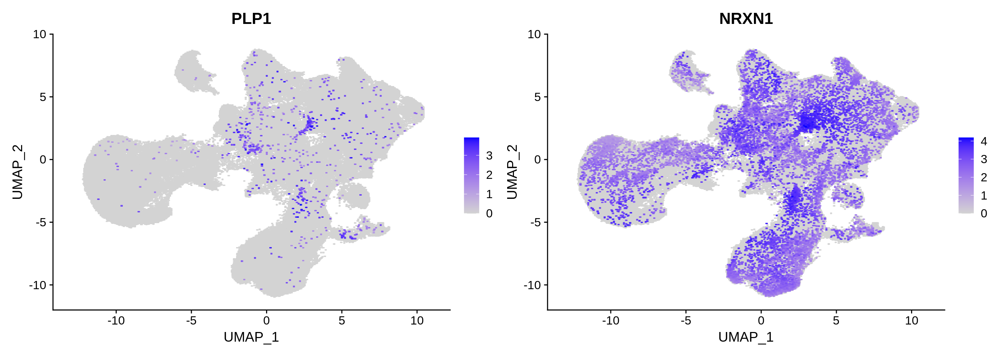

In [43]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("PLP1","NRXN1"),pt.size = pt.size,order = T,ncol=2)

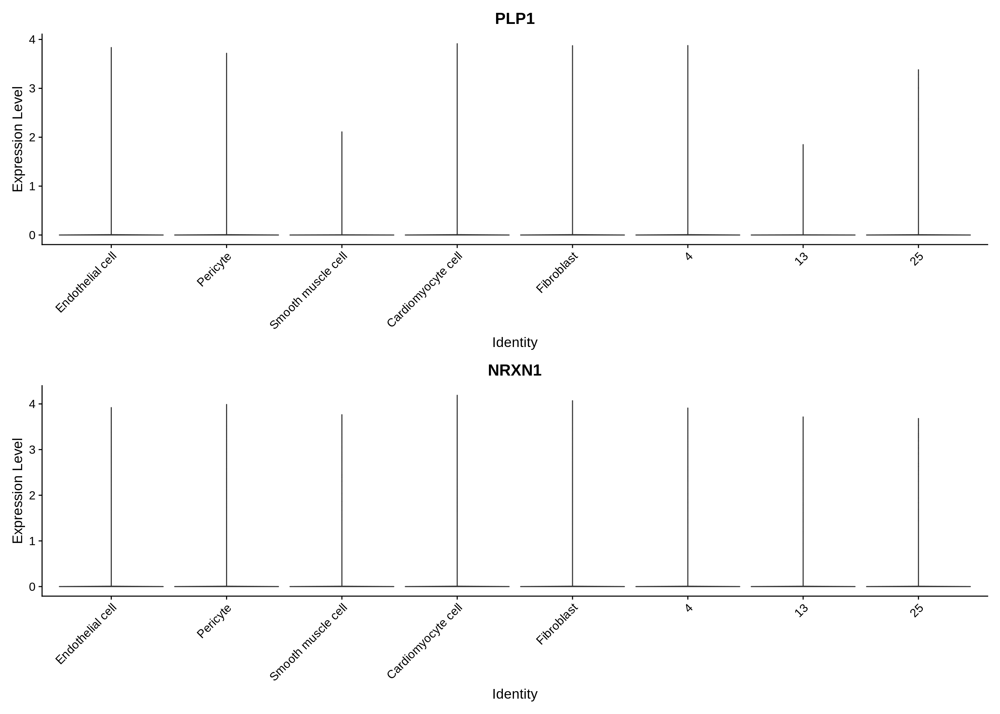

In [44]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("PLP1","NRXN1"),pt.size = 0,ncol=1)

### Neurglial cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message in FeaturePlot(dataobj, features = c("MBP", "PRX", "MPZ"), pt.size = pt.size, :
“All cells have the same value (0) of MBP.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message in FeaturePlot(dataobj, features = c("MBP", "PRX", "MPZ"), pt.size = pt.size, :
“All cells have the same value (0) of PRX.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



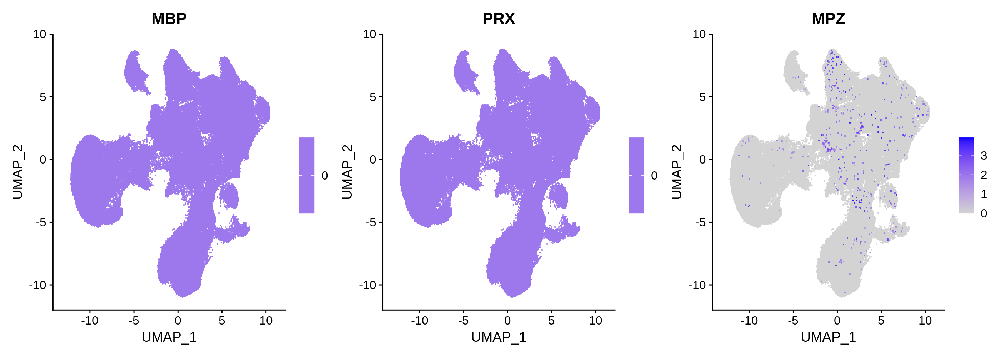

In [45]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MBP","PRX","MPZ"),pt.size = pt.size,order = T,ncol=3)

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of MBP.”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of PRX.”


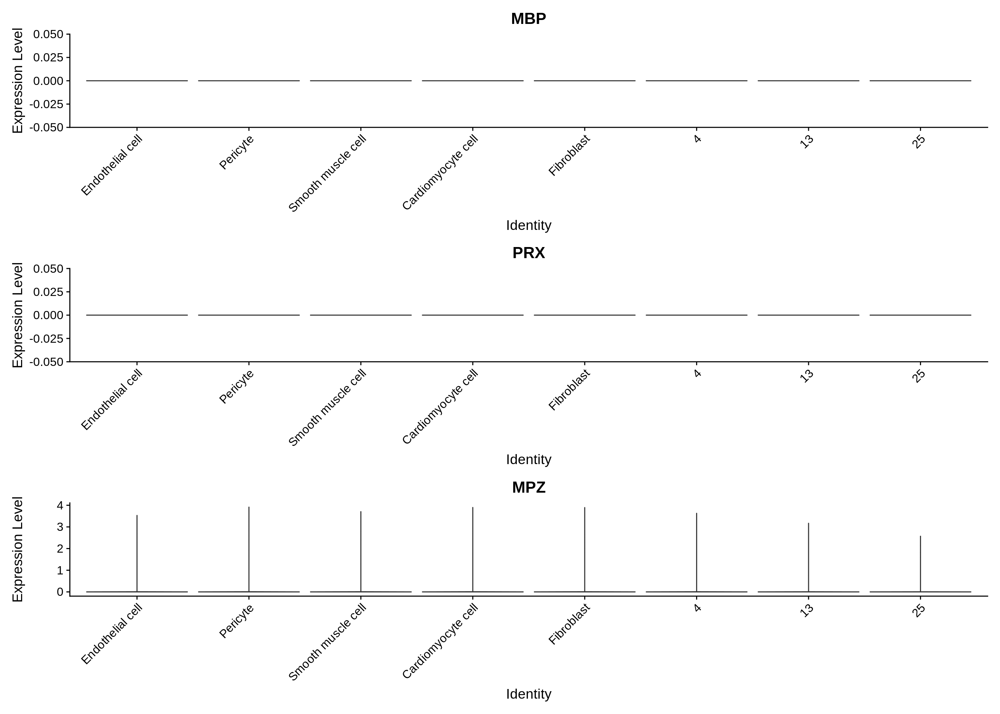

In [46]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MBP","PRX","MPZ"),pt.size = 0,ncol=1)

### Adipocyte

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



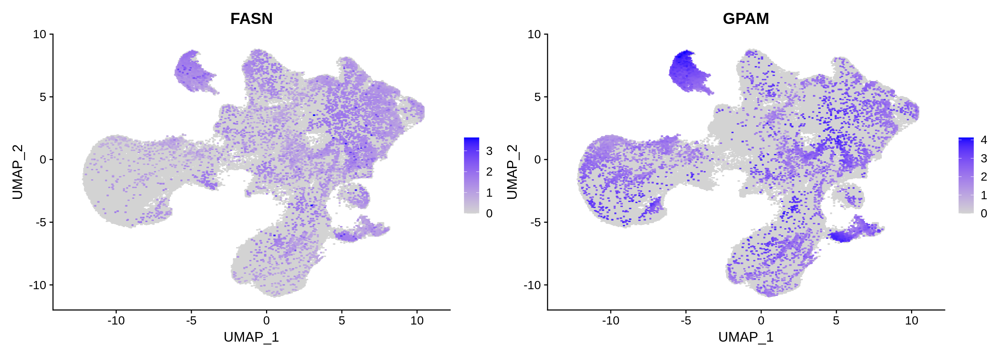

In [47]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("FASN","GPAM"),pt.size = pt.size,order = T,ncol=2)

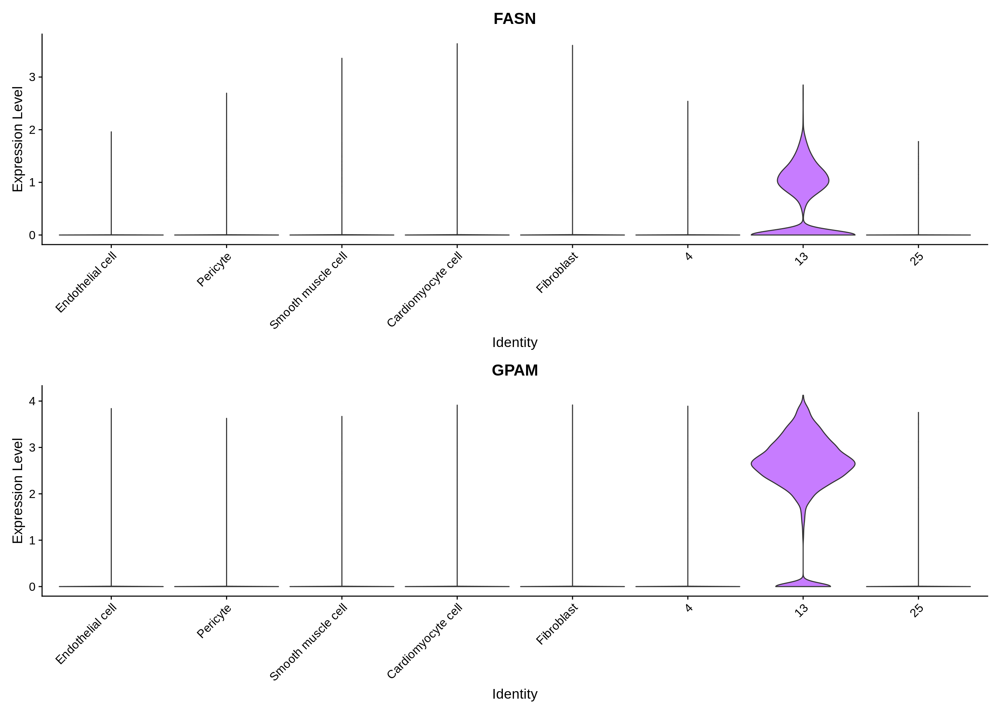

In [48]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("FASN","GPAM"),pt.size = 0,ncol=1)

In [49]:
dataobj <- RenameIdents(object = dataobj,'13' = 'Adipocyte')

### Myeloid cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



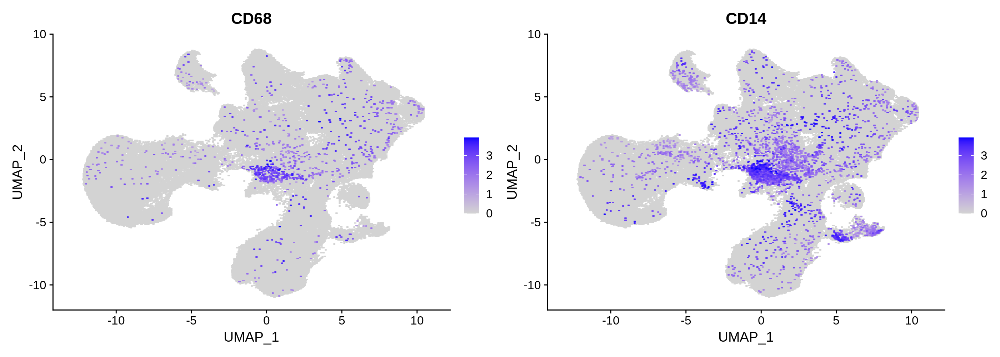

In [50]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("CD68","CD14"),pt.size = pt.size,order = T,ncol=2)

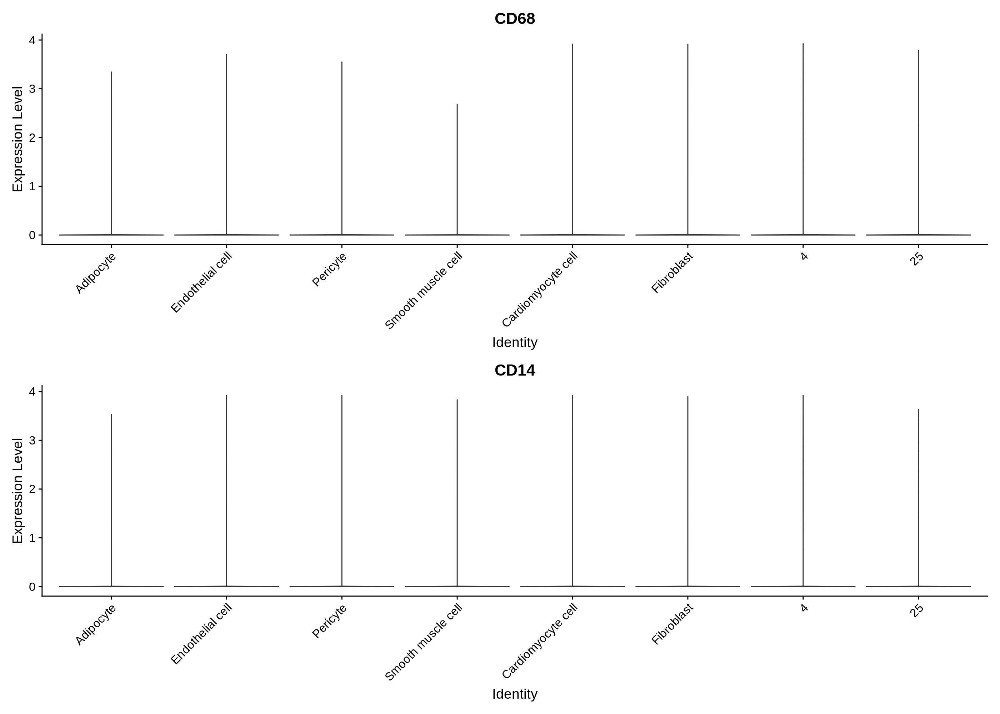

In [51]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("CD68","CD14"),pt.size = 0,ncol=1)

In [52]:
dataobj <- RenameIdents(object = dataobj,'4' = 'Myeloid cell')

### Lymphoid cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



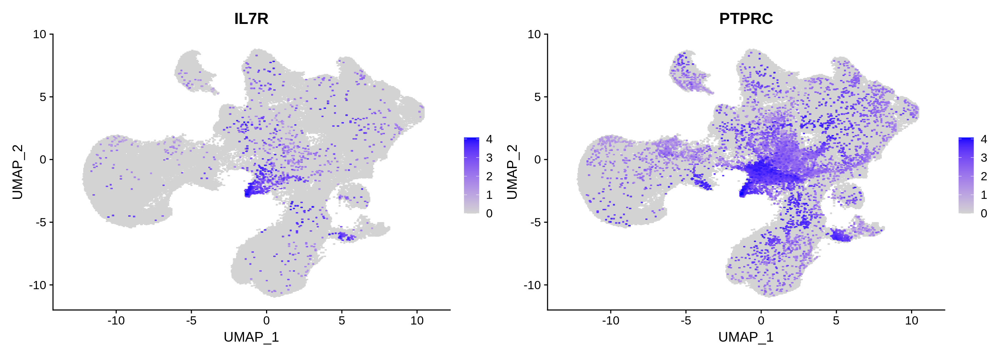

In [53]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("IL7R","PTPRC"),pt.size = pt.size,order = T,ncol=2)

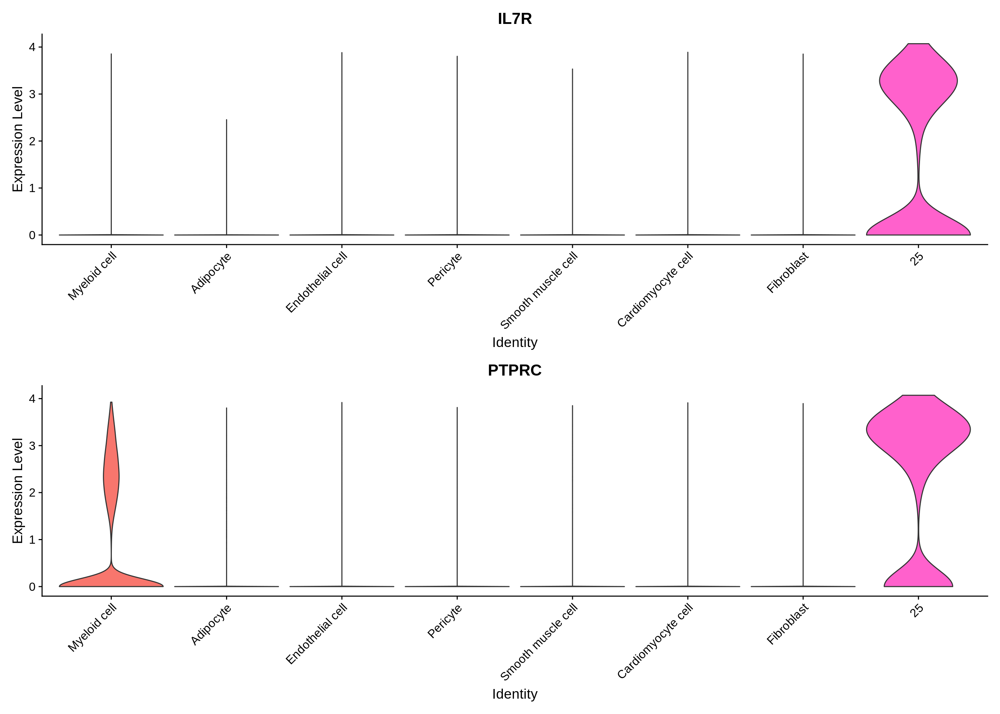

In [54]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("IL7R","PTPRC"),pt.size = 0,ncol=1)

In [55]:
dataobj <- RenameIdents(object = dataobj,'25' = 'Lymphoid cell')

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



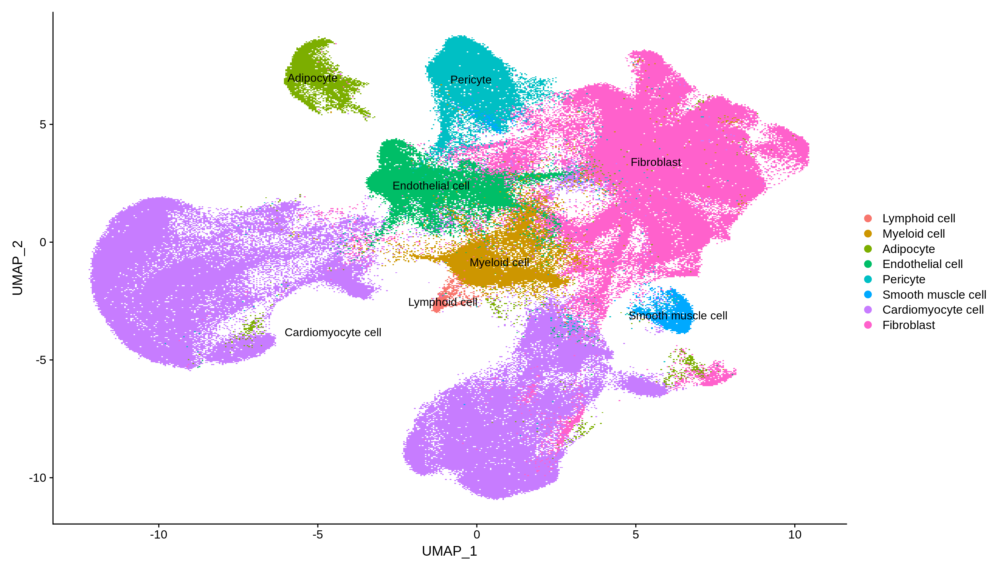

In [56]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T)

In [57]:
dataobj$cell_type <- as.character(Idents(dataobj))

# Sub.celltype Annotation

### Reannotate Endothelial cell

In [3]:
subobj <- subset(dataobj,cell_type =="Endothelial cell")

In [4]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Centering and scaling data matrix



PC_ 1 
Positive:  LAMA2, PRKG1, PLA2G5, PKHD1L1, PCDH15, RYR2, TMEM132C, NPPA, PDE3A, POSTN 
	   GMDS, TTN, NRG3, RBPJ, MYL7, FHL2, ACTC1, MYH6, TNNT2, CEBPB 
	   MT-CO1, MYL4, MYBPC3, CCDC107, RBM24, CRYAB, DES, FBN2, NUDT4, ITGA7 
Negative:  SYNE2, CYYR1, F8, CCDC85A, NRP1, ADGRF5, PLCB1, FOXN3, KIAA1217, GALNT18 
	   DOCK9, CMTM8, FLT1, BTNL9, ARHGAP31, RUNX1T1, PTPRB, A2M, FRYL, CD36 
	   CDC42BPA, SEC14L1, RASGRF2, KALRN, LDLRAD4, GFOD1, KCNQ1OT1, GNAQ, UTRN, RAPGEF2 
PC_ 2 
Positive:  PKHD1L1, PCDH15, TMEM132C, GMDS, MYRIP, POSTN, ST6GAL1, NRG3, PDE7B, LINC-PINT 
	   PRKG1, FOXP1, SLCO2A1, CALCRL, PDE3A, GRK5, PDE4D, ARHGAP26, PLA2G5, NOSTRIN 
	   FOXO1, RALGAPA2, MKLN1, MIR99AHG, PBX1, RBMS3-AS3, ITGA9, PLPP3, FNDC3B, IMMP2L 
Negative:  MT-CO1, MT-CO2, MT-ATP6, MT-ND4, MT-CO3, CD36, MT-ND1, MT-CYB, MT-ND3, TCAP 
	   MT-ND2, ACTC1, DES, TPM1, CRYAB, TNNT2, CKM, MYH7, SLC25A4, MYL7 
	   MYH6, NDUFA4, MYL2, PTGDS, MYL12A, UQCRB, COX4I1, TTN, KIAA1217, MYL9 
PC_ 3 
Positive:  CD36, 

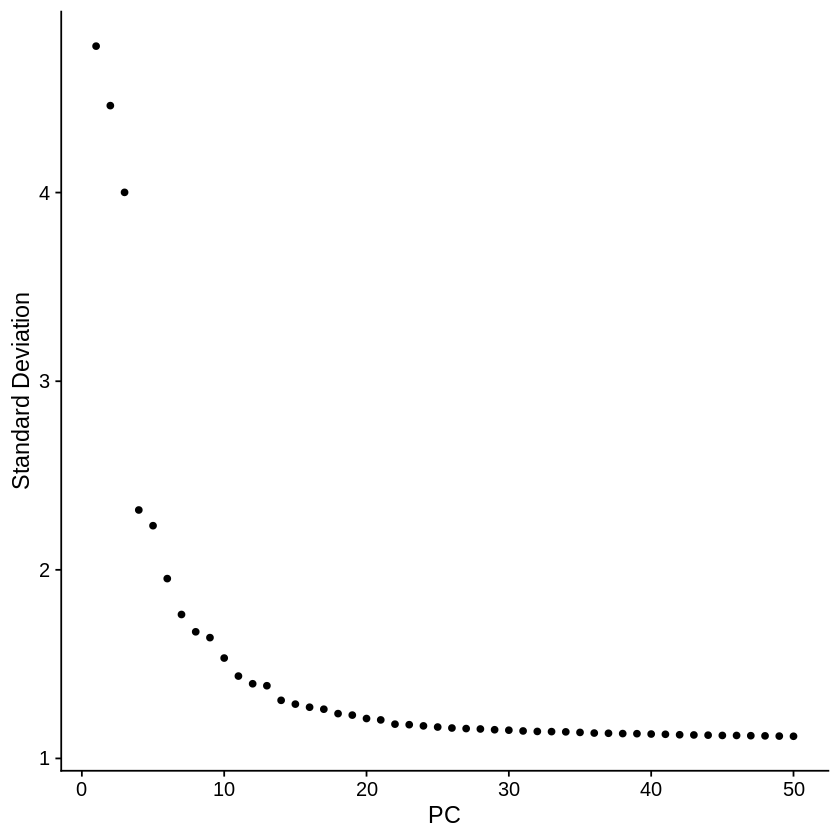

In [5]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [6]:
pcDim = 20

In [7]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
13:30:21 UMAP embedding parameters a = 0.9922 b = 1.112

13:30:21 Read 20093 rows and found 20 numeric columns

13:30:21 Using Annoy for neighbor search, n_neighbors = 30

13:30:21 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:30:23 Writing NN index file to temp file /tmp/RtmpR6OBub/file1128c332b26877

13:30:23 Searching Annoy index using 1 thread, search_k = 3000

13:30:28 Annoy recall = 100%

13:30:29 Commencing smooth kNN distance calibration using 1 thread

13:30:30 Initializing 

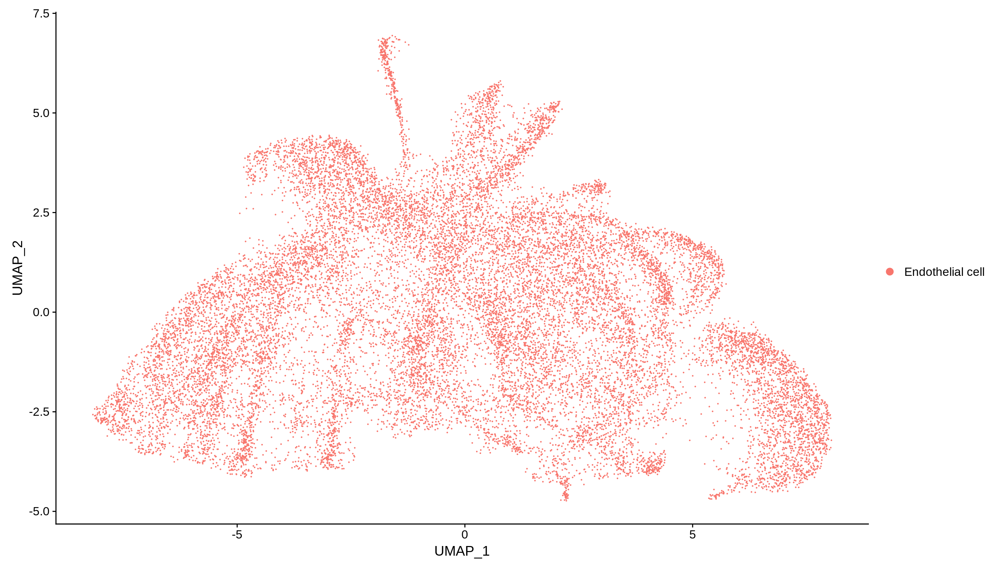

In [8]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

In [24]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.2, n.start = 5)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 20093
Number of edges: 655204

Running Louvain algorithm...
Maximum modularity in 5 random starts: 0.9133
Number of communities: 7
Elapsed time: 1 seconds


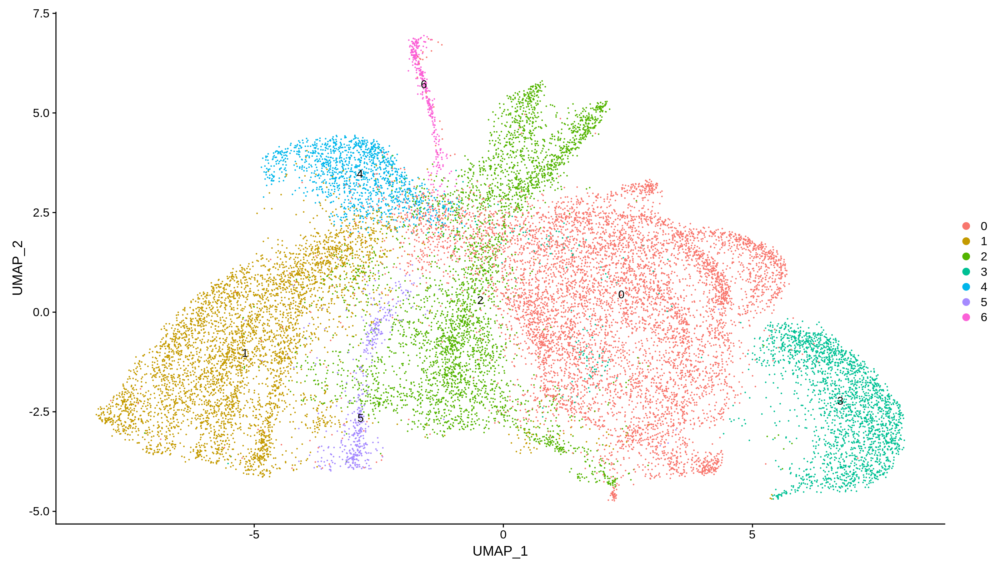

In [25]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

#### Vascular endothelial cell

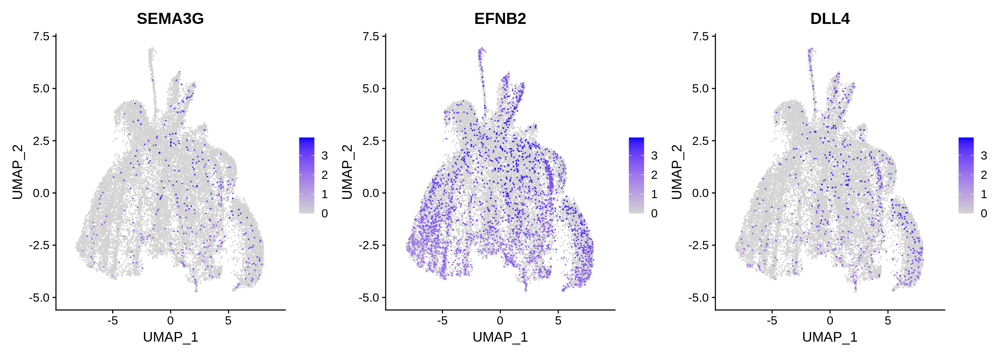

In [26]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=0.1

FeaturePlot(subobj,features = c("SEMA3G","EFNB2","DLL4"),pt.size = pt.size,order = T,ncol=3)

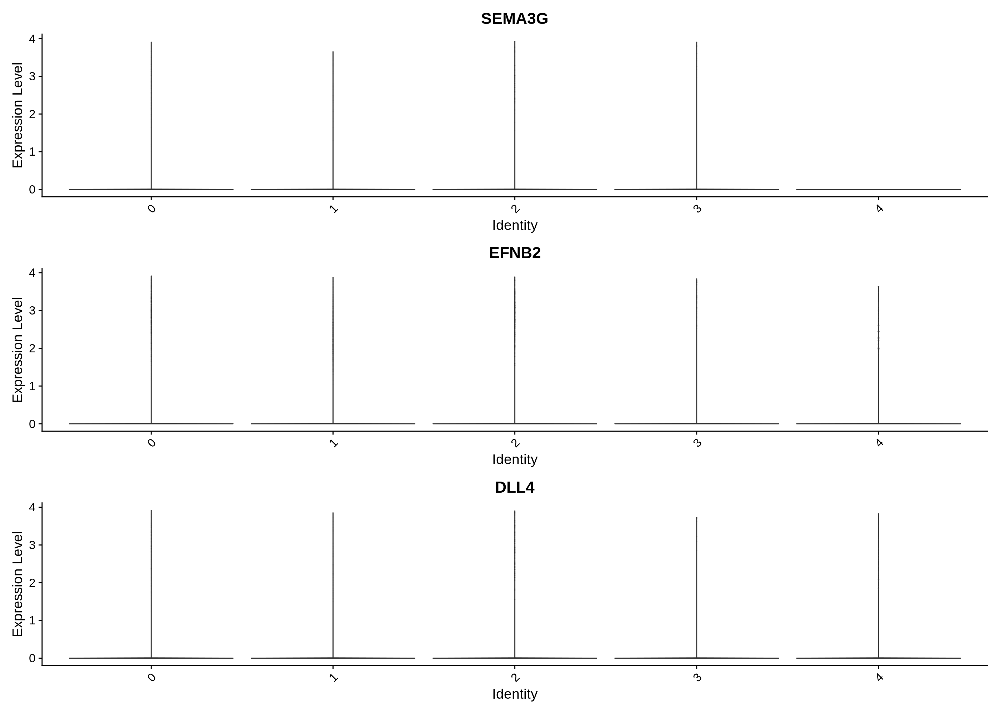

In [12]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("SEMA3G","EFNB2","DLL4"),pt.size = 0,ncol=1)

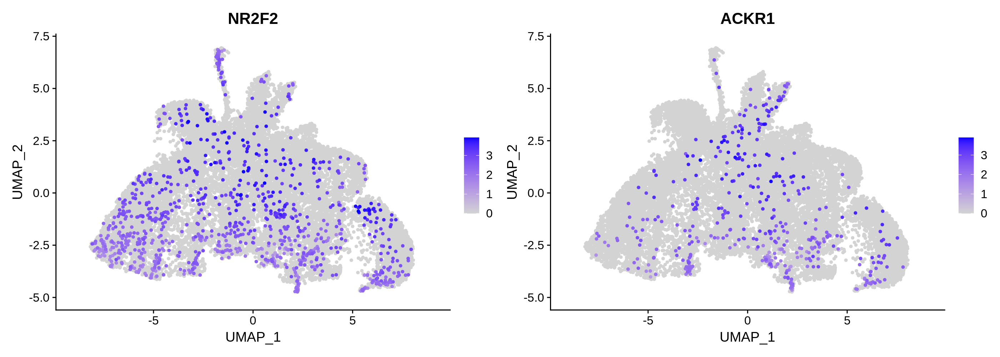

In [27]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("NR2F2","ACKR1"),pt.size = pt.size,order = T,ncol=2)

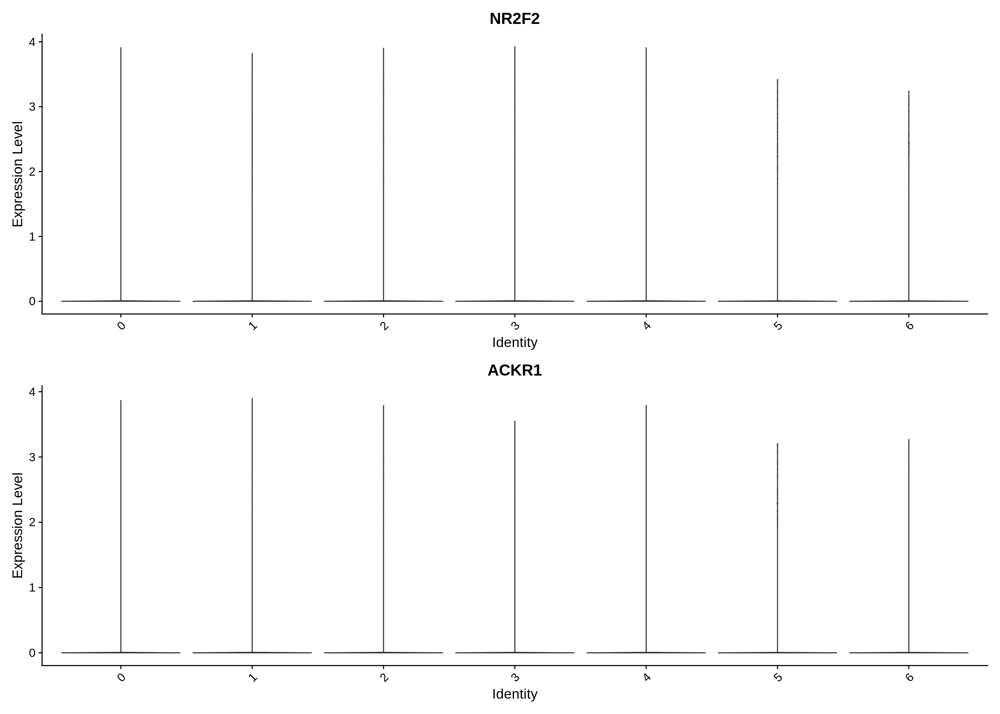

In [28]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("NR2F2","ACKR1"),pt.size = 0,ncol=1)

In [29]:
subobj <- RenameIdents(object = subobj,'4' = 'Vascular endothelial cell','5' = 'Vascular endothelial cell','1' = 'Vascular endothelial cell')

#### Endocardial cell

Warning message in FeaturePlot(subobj, features = c("NPR3"), pt.size = pt.size, :
“All cells have the same value (0) of NPR3.”


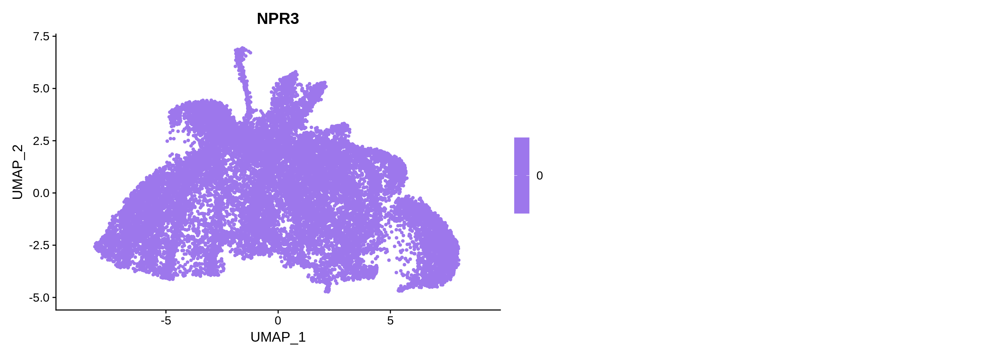

In [15]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("NPR3"),pt.size = pt.size,order = T,ncol=2)

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of NPR3.”


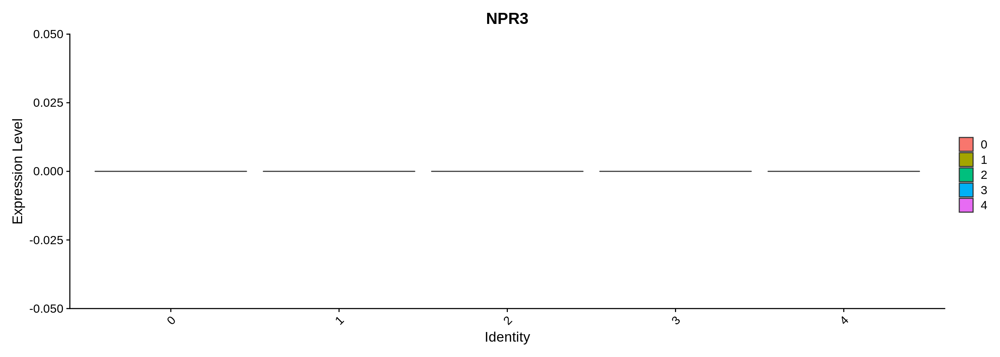

In [16]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

VlnPlot(subobj,features = c("NPR3"),pt.size = 0,ncol=1)

#### Lymphatic endothelial cell

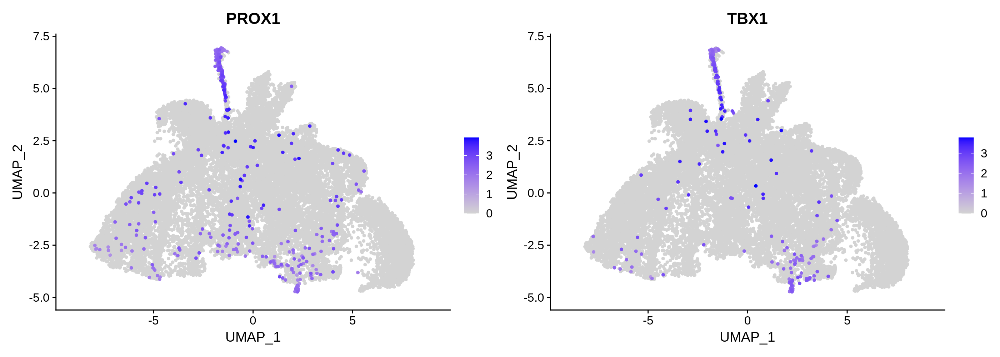

In [30]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("PROX1","TBX1"),pt.size = pt.size,order = T,ncol=2)

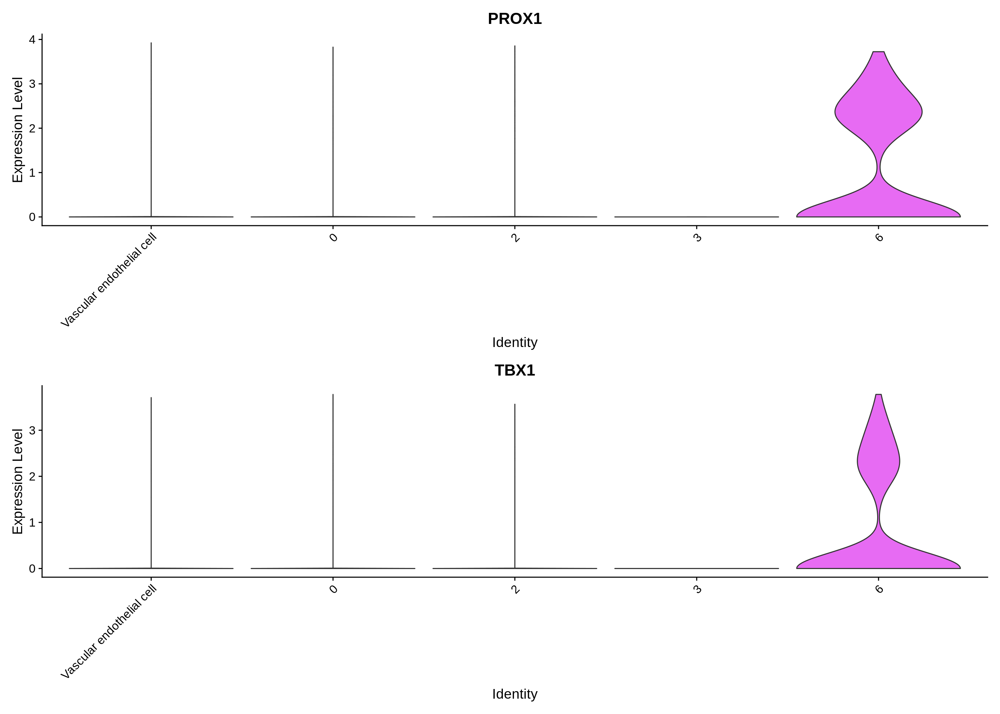

In [31]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("PROX1","TBX1"),pt.size = 0,ncol=1)

In [32]:
subobj <- RenameIdents(object = subobj,'6' = 'Lymphatic endothelial cell')

#### Capillary endothelial cell

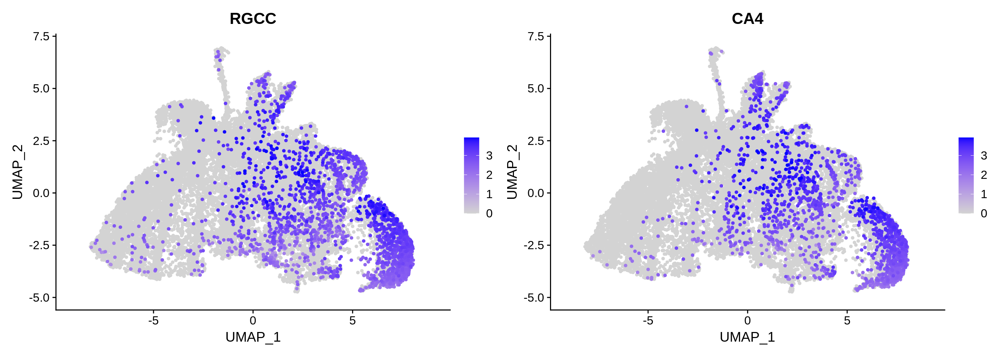

In [20]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("RGCC","CA4"),pt.size = pt.size,order = T,ncol=2)

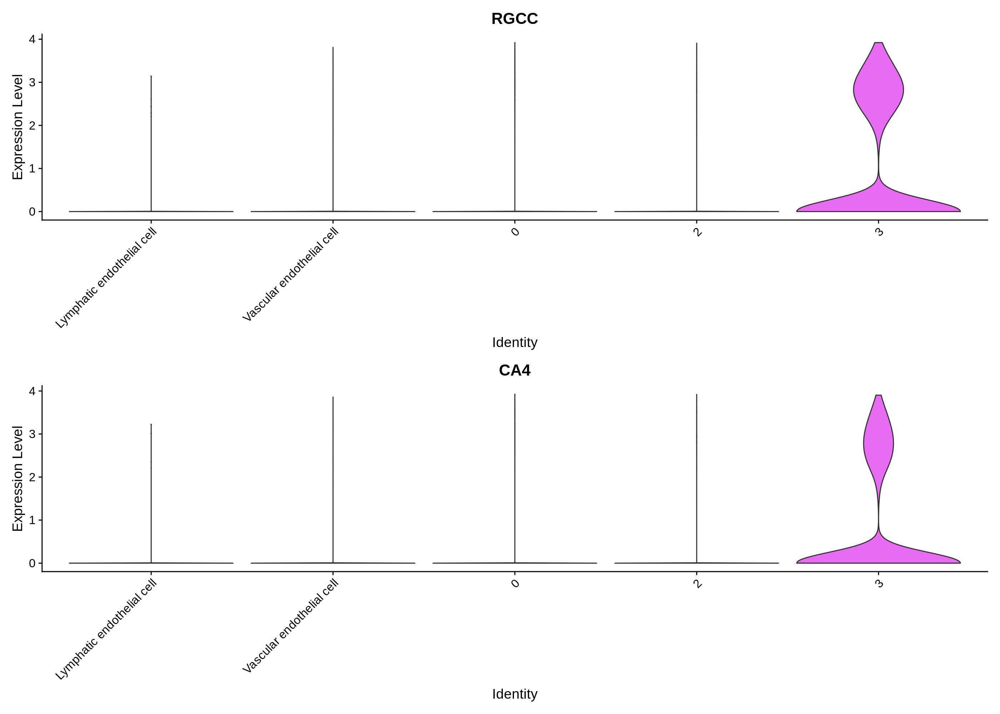

In [33]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
VlnPlot(subobj,features = c("RGCC","CA4"),pt.size = 0,ncol=1)

In [34]:
subobj <- RenameIdents(object = subobj,'2' = 'Capillary endothelial cell','3' = 'Capillary endothelial cell','0' = 'Capillary endothelial cell')

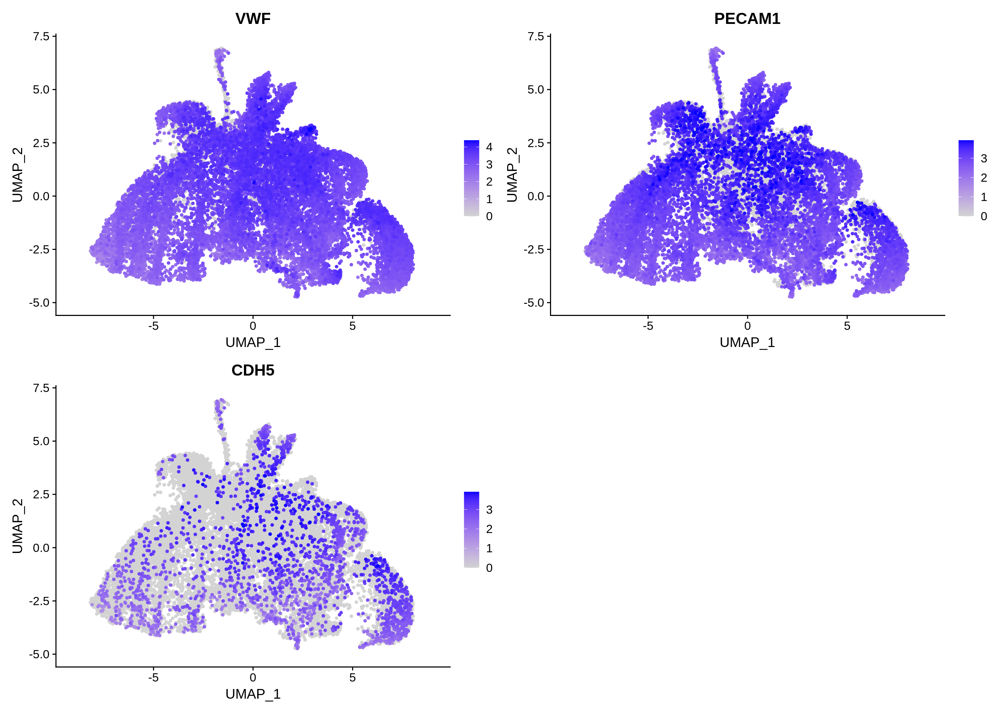

In [23]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("VWF","PECAM1","CDH5"),pt.size = pt.size,order = T,ncol=2)

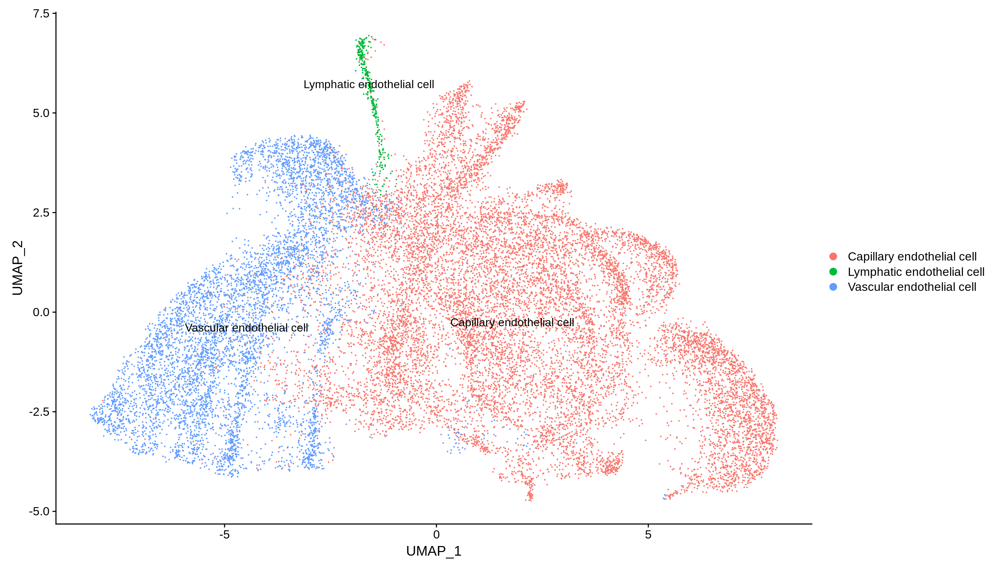

In [35]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [36]:
# save the subtypes
dataobj$sub.cell_type <- dataobj$cell_type
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

### Reannotate Fibroblast

In [84]:
subobj <- subset(dataobj,cell_type =="Fibroblast")

In [85]:
subobj <- FindVariableFeatures(subobj)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”


Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 1224 features requested have not been scaled (running reduction without them): LINC00837, MAFA-AS1, LINC00561, DANT1, LINC02600, FPGT, LINC01626, PRLH, IL17C, LINC00572, FAM90A26, OR1E1, LINC01267, LINC00500, TIGD3, NAV2, UGT1A8, ZHX1, C1orf116, SFTPC, ZG16, PRB4, SOX21-AS1, BCL2L10, DAOA, KRTAP19-3, LINC00604, TAS2R9, LRRC3-DT, LINC00374, TBX20, HAND1, LINC01489, KLK4, GCSAML-AS1, PXDNL, LINC01351, ANHX, ENPP7, BIRC7, LINC01088, DDX5, MSI2, PDE4D, TREML2, SLC2A13, ARL14EPL, NID1, SSTR5, FCN2, FOXP2, PSMA6, HIF3A, PCOLCE2, SIK3, COL2A1, H2AC8, SLAMF9, PTPRS, LINC00345, TXNRD1, LRRC2-AS1, EXT1, F10-AS1, FMC1, PATE2, CACNA2D1, TNK2-AS1, COL4A4, LGR4, COL4A1, ARHGAP24, COL8A1, LINGO1-AS1, ZEB1, SSH2, ATP6V1G2-DDX39B, LHFPL6, DCUN1D3, VPS13A-AS1, KRT34, FOXO3, CREB5, PDXDC1, DAAM1, SMCR2, SSBP2, CFAP99, USP53, ABTB2, SPTBN1, GAB2, LINC01247, PARD3B, MEIS2, BNC2, SACS-AS1, HTR3C, NKX2-6, WSB1,

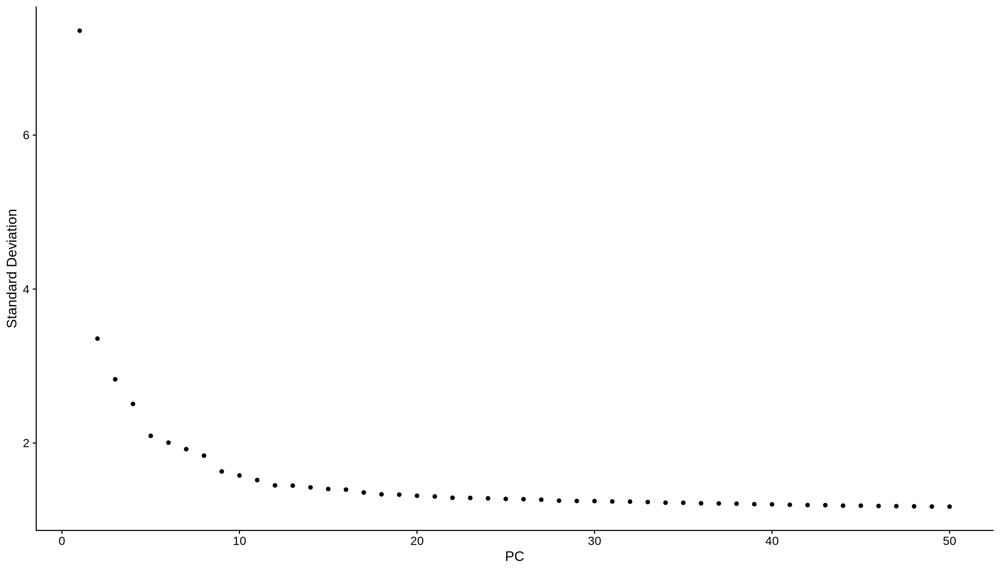

In [86]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [87]:
pcDim = 15

In [88]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

16:07:02 UMAP embedding parameters a = 0.9922 b = 1.112

16:07:02 Read 86349 rows and found 15 numeric columns

16:07:02 Using Annoy for neighbor search, n_neighbors = 30

16:07:02 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:07:10 Writing NN index file to temp file /tmp/RtmpAbE7Wn/file16bc6f6fd026e2

16:07:10 Searching Annoy index using 1 thread, search_k = 3000

16:07:40 Annoy recall = 100%

16:07:40 Commencing smooth kNN distance calibration using 1 thread

16:07:43 Initializing from normalized Laplacian + noise

16:07:47 Commencing optimization for 200 epochs, with 3646434 positive edges

16:08:27 Optimization finished



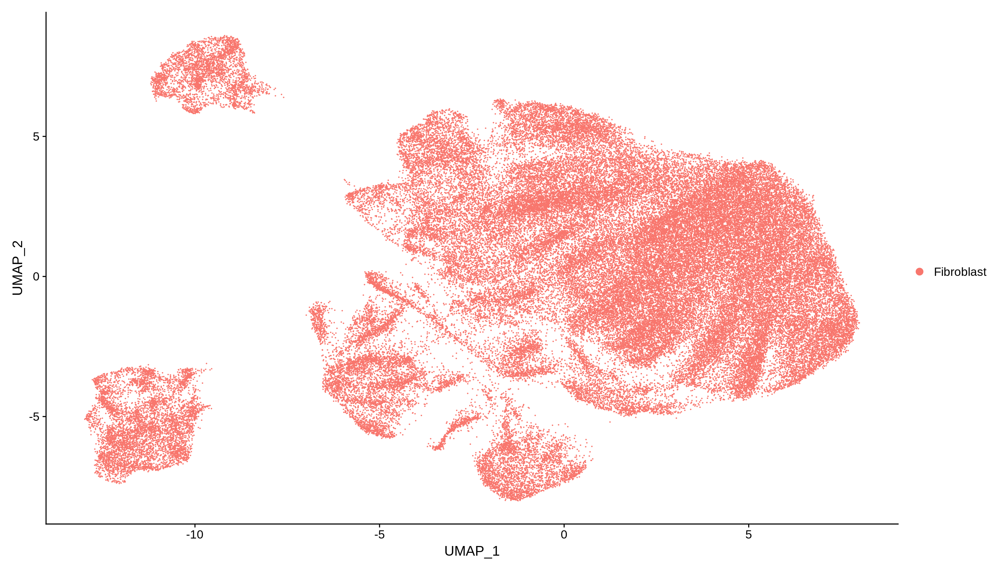

In [89]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

In [92]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.1, n.start = 5)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 86349
Number of edges: 2500242

Running Louvain algorithm...
Maximum modularity in 5 random starts: 0.9501
Number of communities: 9
Elapsed time: 15 seconds


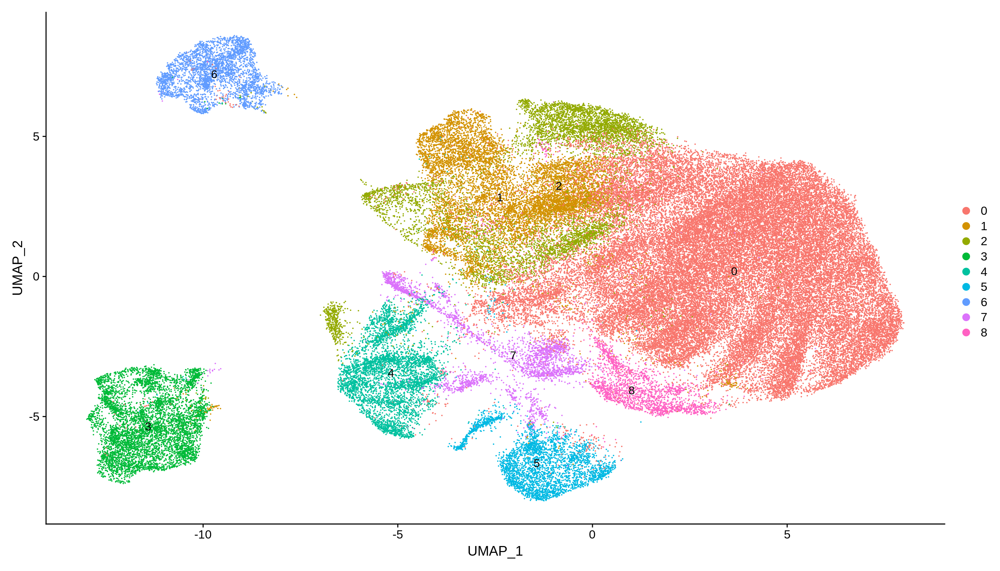

In [93]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

#### Myofibroblast

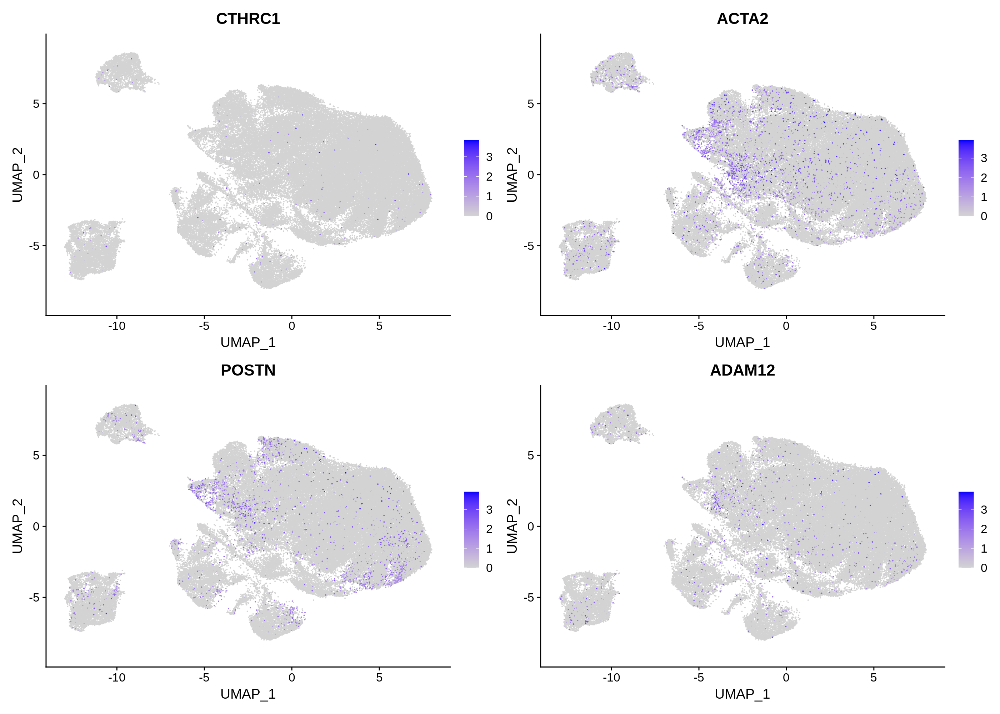

In [94]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("CTHRC1","ACTA2","POSTN","ADAM12"))


#### Fibrocyte

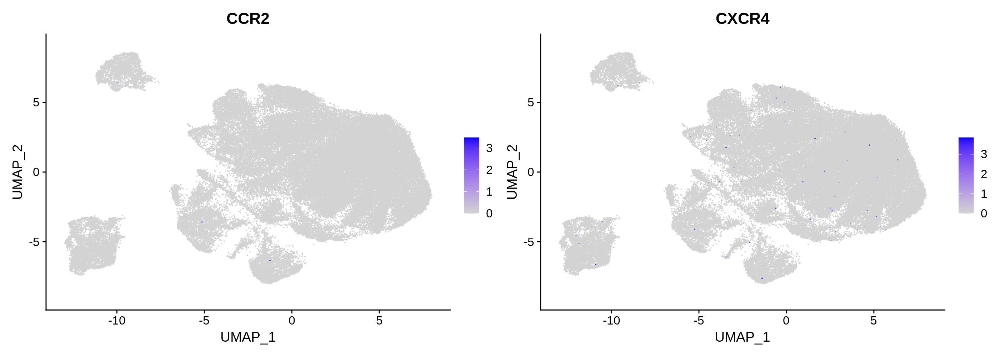

In [95]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
FeaturePlot(subobj,c("CCR2","CXCR4"))


#### Basement membrane fibroblast

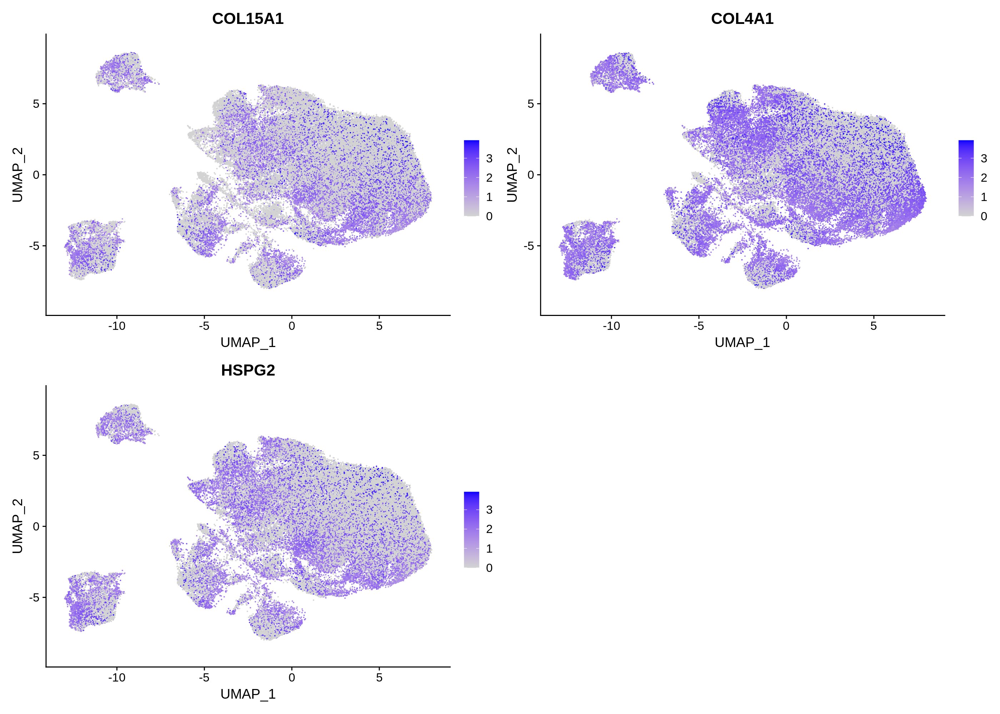

In [96]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("COL15A1","COL4A1","HSPG2"))


In [100]:
subobj <- RenameIdents(object = subobj,'0' = 'Basement membrane fibroblast','1' = 'Basement membrane fibroblast','2' = 'Basement membrane fibroblast','7' = 'Basement membrane fibroblast','4' = 'Basement membrane fibroblast','5' = 'Basement membrane fibroblast','6' = 'Basement membrane fibroblast','8' = 'Basement membrane fibroblast')

#### Adventitial fibroblast

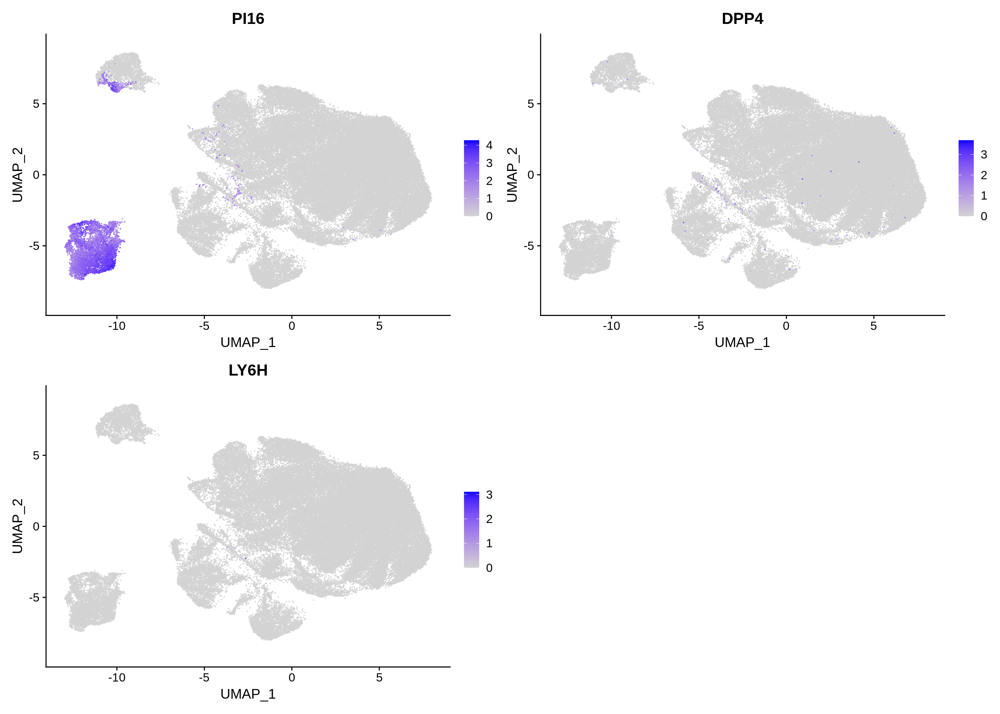

In [97]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PI16","DPP4","LY6H"))


In [99]:
subobj <- RenameIdents(object = subobj,'3' = 'Adventitial fibroblast')

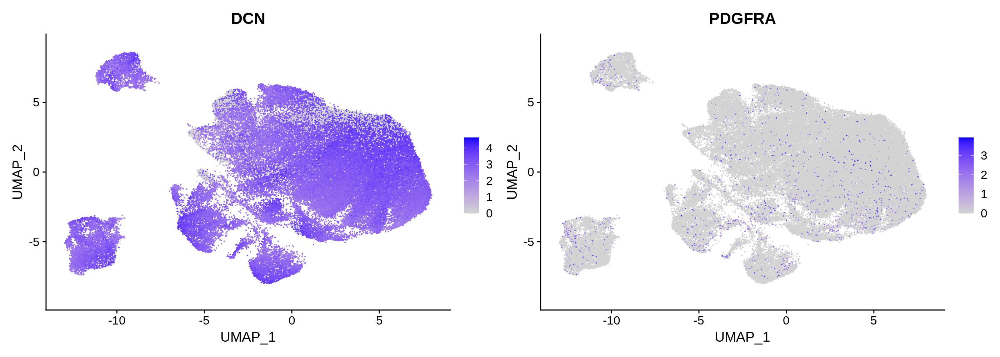

In [98]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
FeaturePlot(subobj,c("DCN","PDGFRA"))


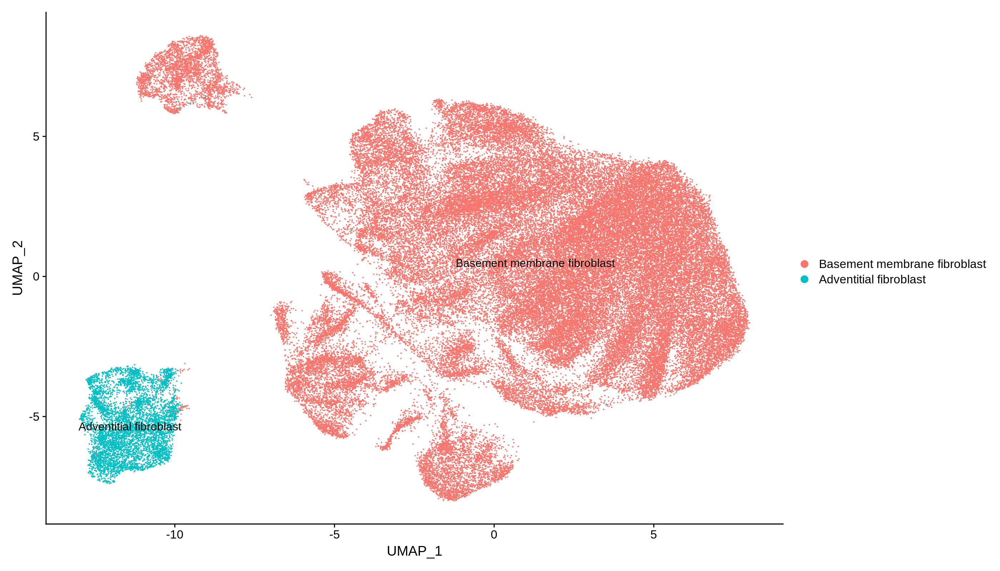

In [101]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [102]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

### Reannotate Myeloid cell

In [103]:
subobj <- subset(dataobj,cell_type =="Myeloid cell")

In [104]:
subobj <- FindVariableFeatures(subobj)
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”


Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 1341 features requested have not been scaled (running reduction without them): CRB3, LINC00706, MIOX, LINC01625, PLS1-AS1, TEKT2, TMEM82, NMS, FAM47E, DPPA3, INO80C, LINC00334, TDRG1, PROC, LAMA2, STPG3, DPRX, CCN6, NECAB2, LINC01208, MTUS2-AS1, CHST13, CAPSL, C8orf74, SMAD1-AS1, APOBEC3B-AS1, S100A11P1, LINC02154, CPA5, TCP10L, UBXN10, GZMB, TMEM132E, FAM224A, GBP6, LINC00332, PLA2G2D, TAL2, MIR1915HG, NAV2-AS4, C8orf89, NXT2, ANKRD45, NYAP1, KRT16, SLC38A5, LINC-ROR, MRPS9-AS1, CECR3, CA3-AS1, CATSPERZ, LINC01412, RAB39B, COL18A1-AS1, TSC22D1-AS1, FABP2, RET, TMIE, LINC01514, MIXL1, RAD21L1, ZNF664, SATB2-AS1, LINC00701, SYNE1-AS1, MED4-AS1, URGCP-MRPS24, LARGE2, CYP2C9, DEFB119, PRKCZ-AS1, S100P, NAP1L6P, TMEM139, LIPJ, KRT78, H3C13, MIR124-1HG, PRRT1, EGFL6, LINC01018, H2AC12, HYI-AS1, DNAJB4, CCDC105, ELOA2, GOT1L1, CADM2-AS2, DDR1-DT, SIAH3, PLCE1-AS1, MATN4, LINC00994, CCDC78, POTE

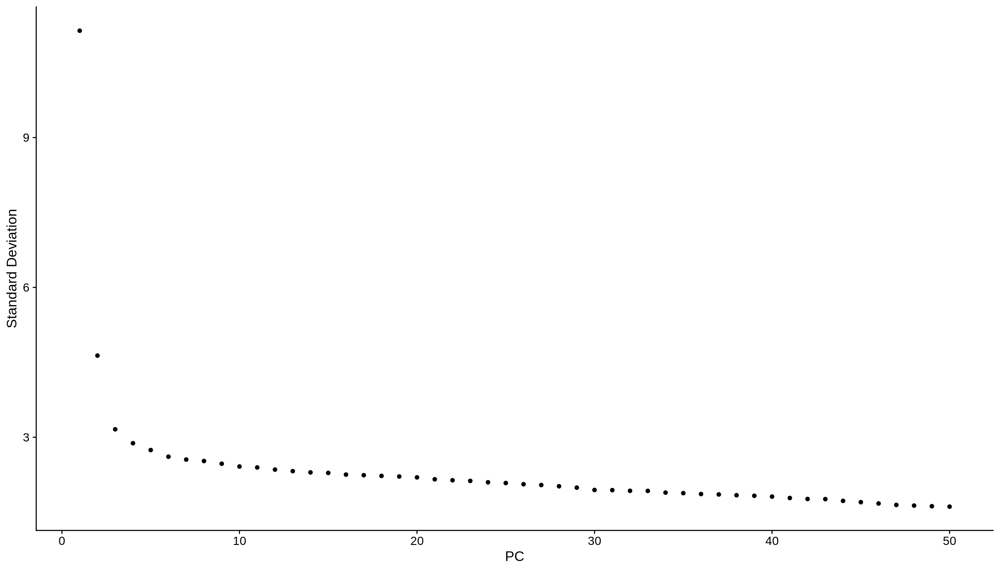

In [105]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [106]:
pcDim = 15

In [107]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

16:14:24 UMAP embedding parameters a = 0.9922 b = 1.112

16:14:24 Read 14994 rows and found 15 numeric columns

16:14:24 Using Annoy for neighbor search, n_neighbors = 30

16:14:24 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:14:25 Writing NN index file to temp file /tmp/RtmpAbE7Wn/file16bc6f6d715c71

16:14:25 Searching Annoy index using 1 thread, search_k = 3000

16:14:30 Annoy recall = 100%

16:14:30 Commencing smooth kNN distance calibration using 1 thread

16:14:31 Initializing from normalized Laplacian + noise

16:14:32 Commencing optimization for 200 epochs, with 605160 positive edges

16:14:37 Optimization finished



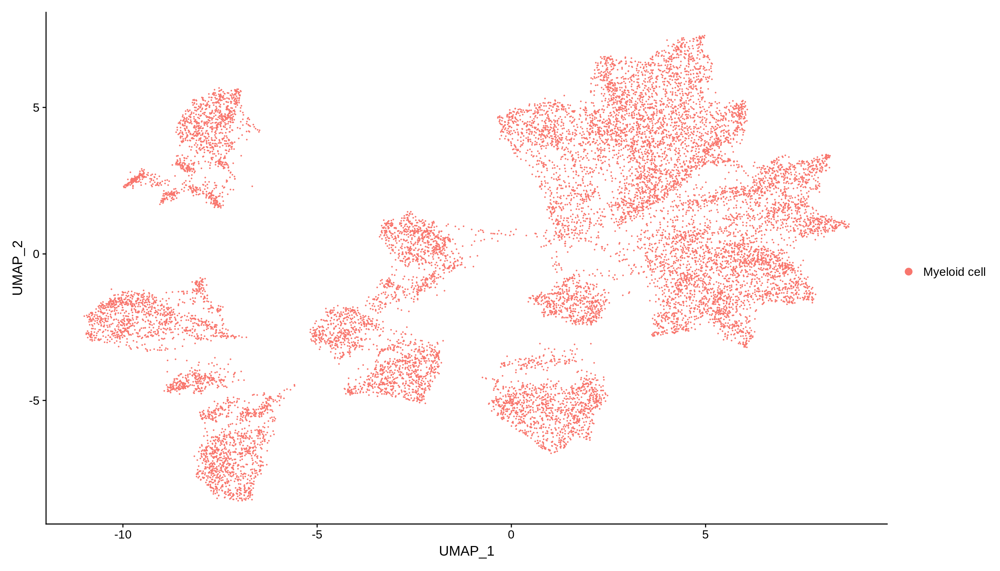

In [108]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

In [109]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.5, n.start = 2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14994
Number of edges: 474239

Running Louvain algorithm...
Maximum modularity in 2 random starts: 0.9019
Number of communities: 13
Elapsed time: 0 seconds


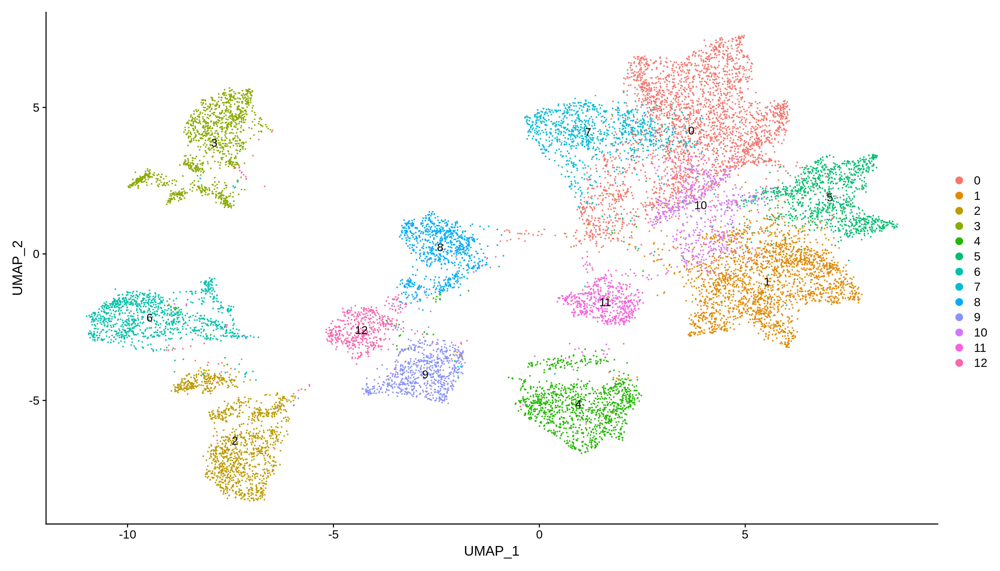

In [110]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

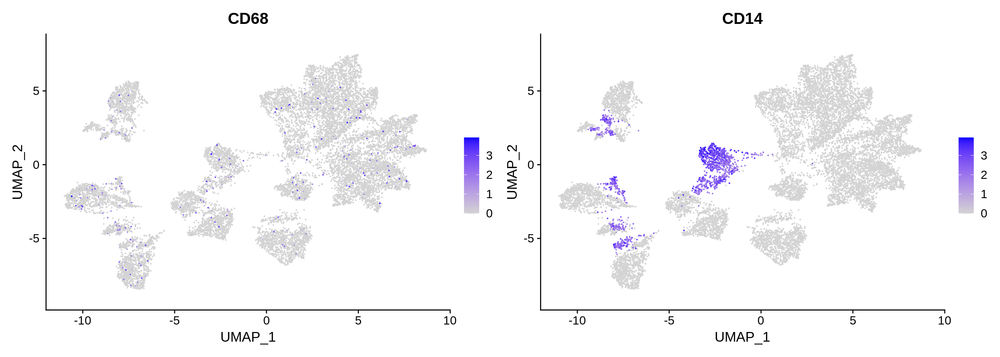

In [111]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CD68","CD14"))

#### Neutrophilic granulocyte

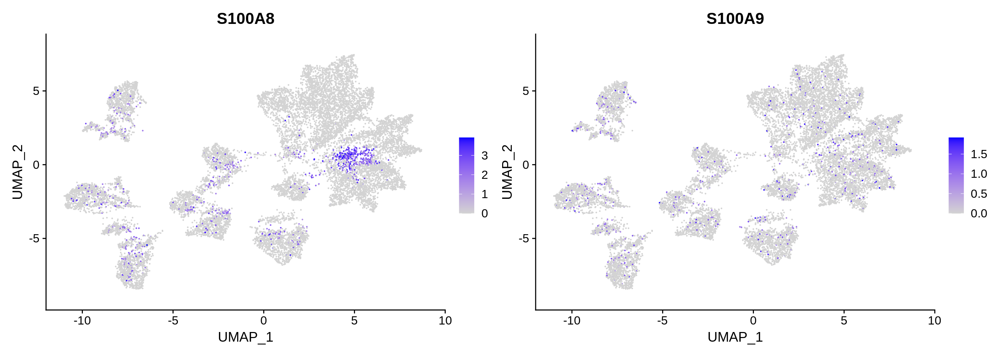

In [112]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("S100A8","S100A9"))


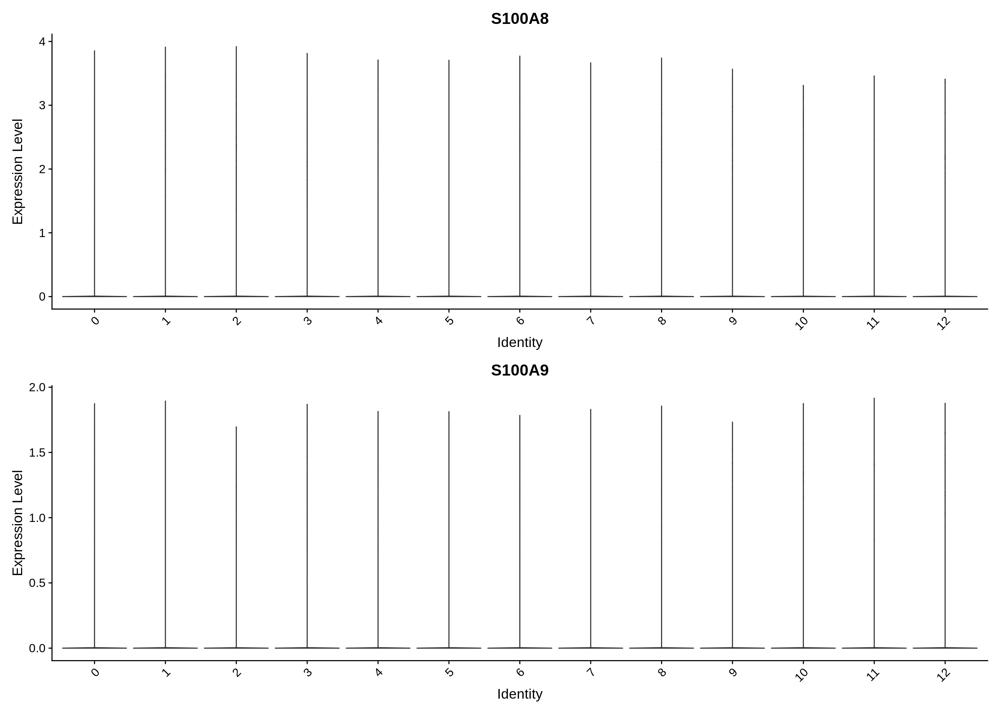

In [113]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("S100A8","S100A9"),pt.size = 0,ncol=1)

In [ ]:
subobj <- RenameIdents(object = subobj,'17' = 'Neutrophilic granulocyte','4' = 'Neutrophilic granulocyte')

#### Mast cell

Warning message in FeaturePlot(subobj, c("MS4A2", "CPA3", "TPSAB1")):
“All cells have the same value (0) of MS4A2.”
Warning message in FeaturePlot(subobj, c("MS4A2", "CPA3", "TPSAB1")):
“All cells have the same value (0) of CPA3.”


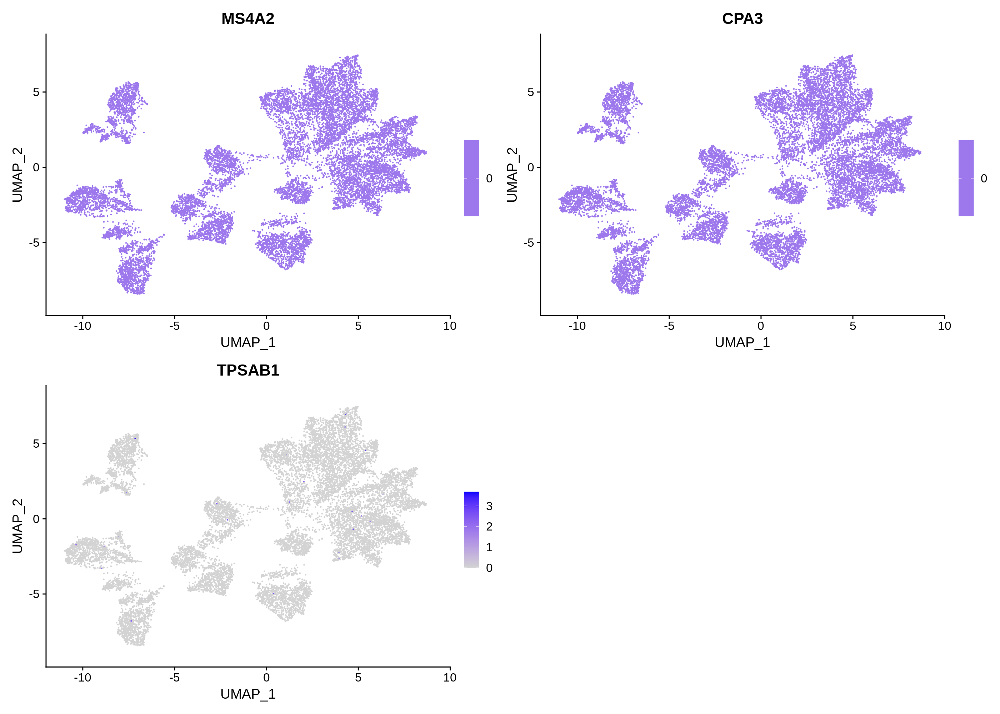

In [114]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("MS4A2","CPA3","TPSAB1"))


Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of MS4A2.”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of CPA3.”


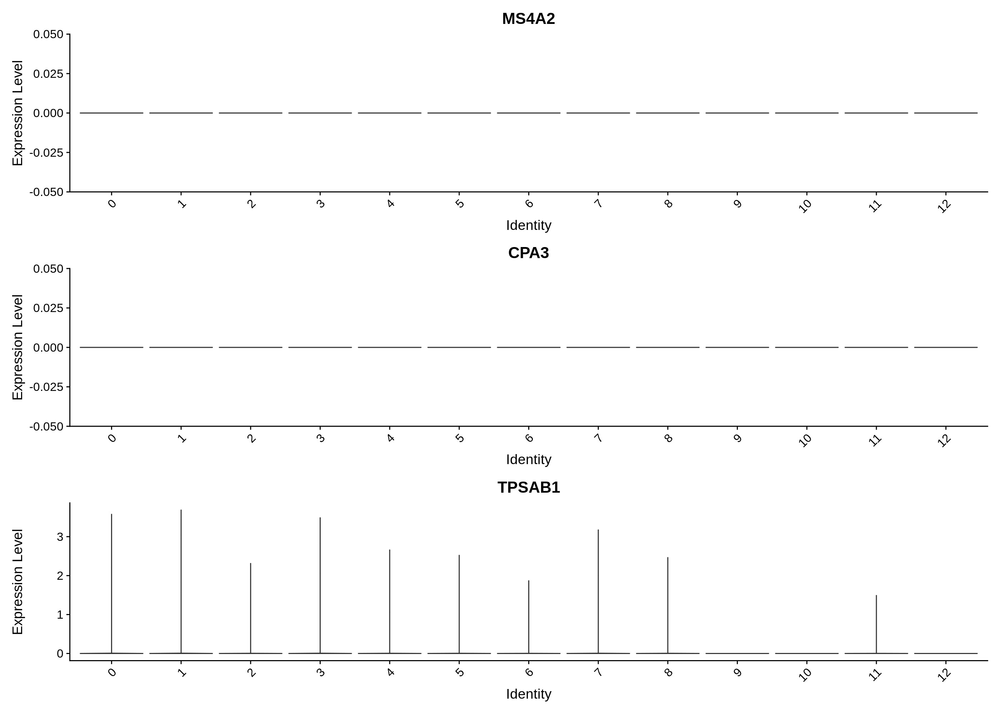

In [115]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("MS4A2","CPA3","TPSAB1"),pt.size = 0,ncol=1)

### Dendritic cell

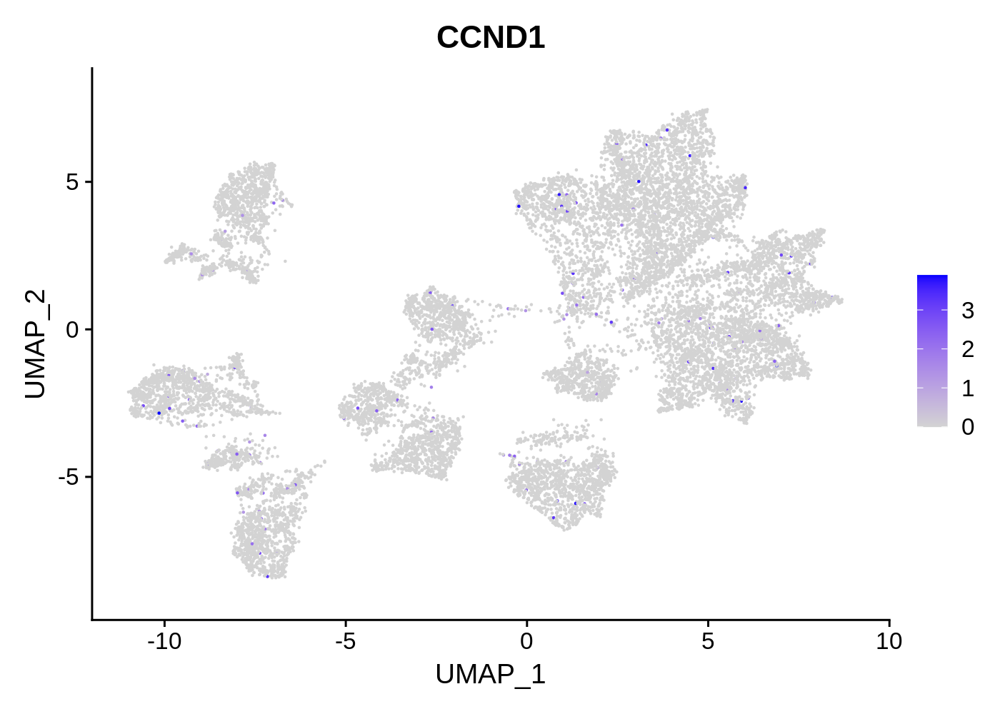

In [116]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CCND1"))


### Monocyte

Warning message in FeaturePlot(subobj, c("CD14", "FCGR3A", "PLAC8")):
“All cells have the same value (0) of PLAC8.”


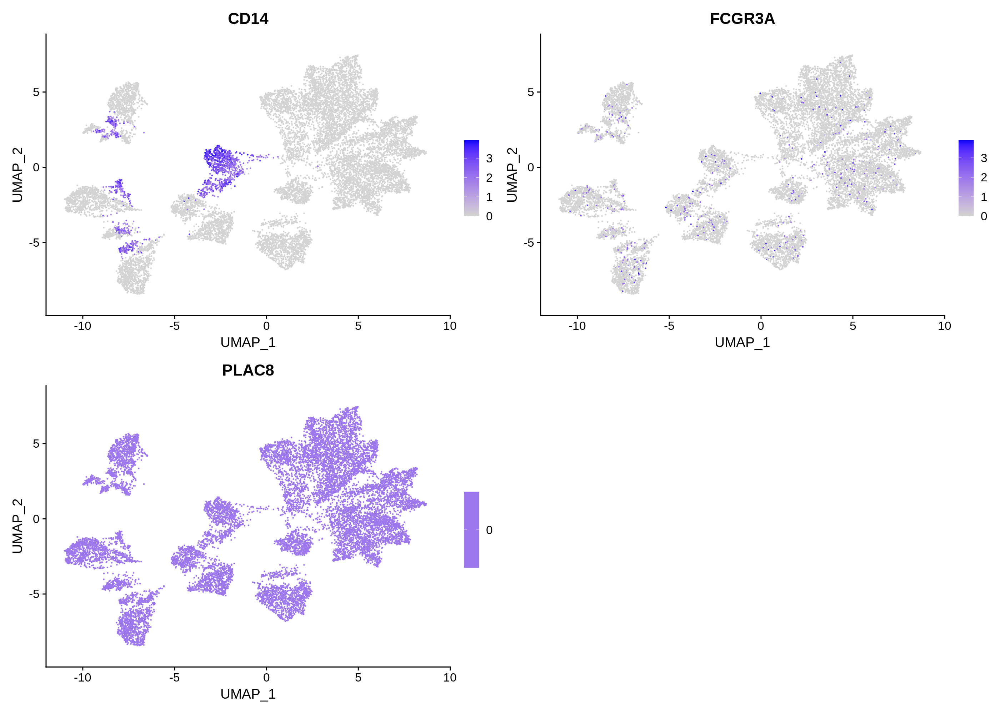

In [117]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("CD14","FCGR3A","PLAC8"))


Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of PLAC8.”


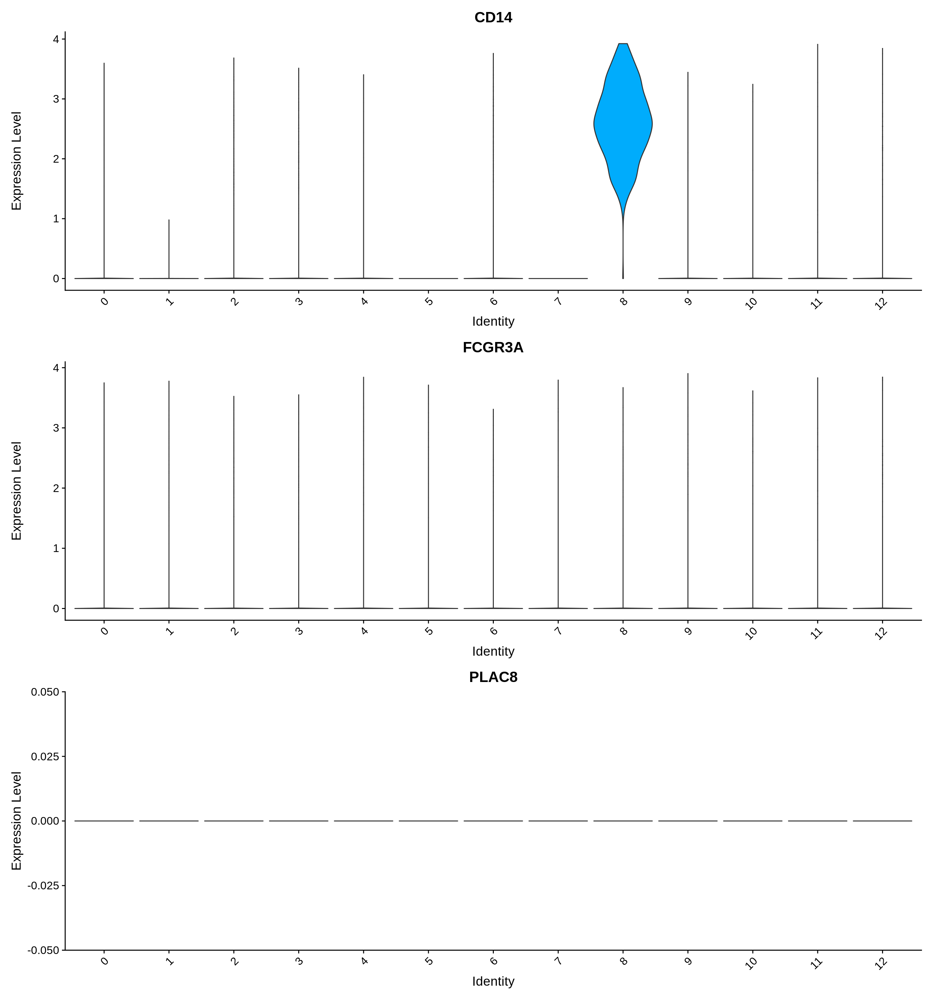

In [118]:
options(repr.plot.width=14, repr.plot.height=5*3, repr.plot.res = 200)

VlnPlot(subobj,features = c("CD14","FCGR3A","PLAC8"),pt.size = 0,ncol=1)

In [119]:
subobj <- RenameIdents(object = subobj,'8' = 'Monocyte')

### Macrophage

Warning message in FeaturePlot(subobj, c("PLAC8", "MSR1", "MRC1")):
“All cells have the same value (0) of PLAC8.”


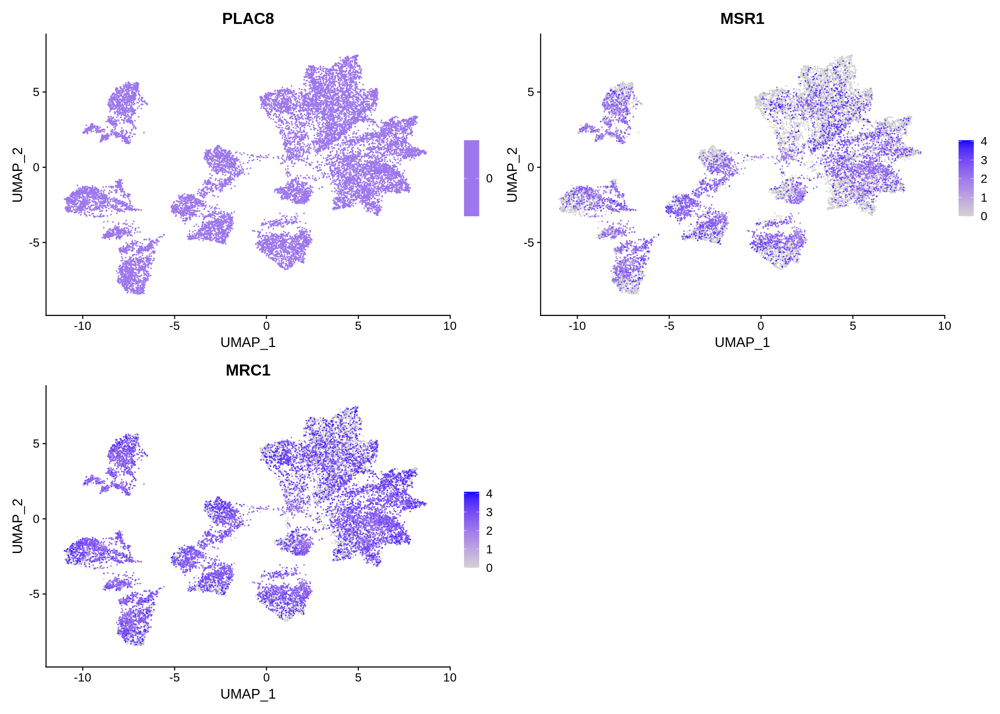

In [120]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PLAC8","MSR1","MRC1"))


Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of PLAC8.”


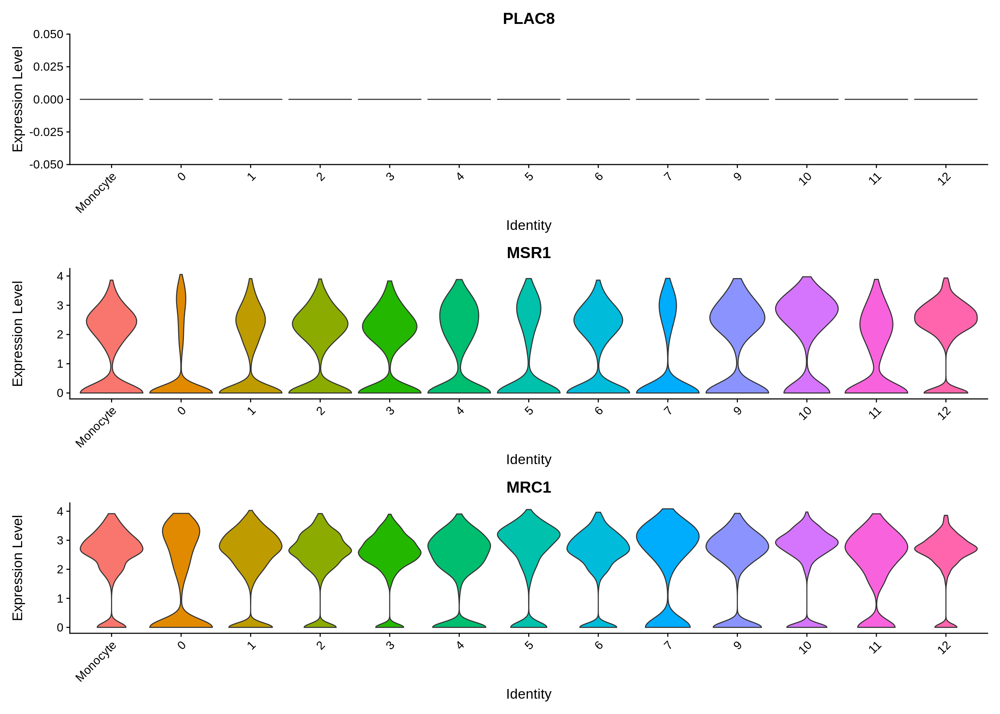

In [121]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("PLAC8","MSR1","MRC1"),pt.size = 0,ncol=1)

In [122]:
subobj <- RenameIdents(object = subobj,'0' = 'Macrophage','1'='Macrophage','2'='Macrophage','3'='Macrophage','4'='Macrophage','5'='Macrophage','6'='Macrophage','7'='Macrophage','9'='Macrophage','10'='Macrophage','11'='Macrophage','12'='Macrophage')

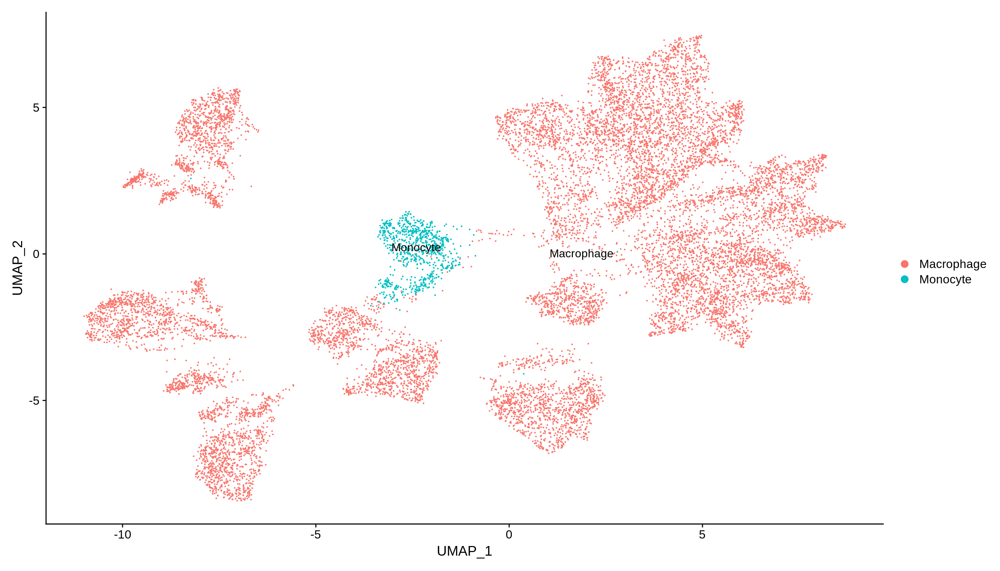

In [123]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [124]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

In [125]:
subobj <- subset(dataobj,sub.cell_type =="Macrophage")

In [126]:
subobj <- FindVariableFeatures(subobj)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”


Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 1348 features requested have not been scaled (running reduction without them): CRB3, LINC00706, MIOX, LINC01625, PLS1-AS1, TEKT2, DDR1-DT, TMEM82, NMS, FAM47E, DPPA3, INO80C, TDRG1, LINC00334, PROC, LAMA2, TMEM139, STPG3, NYAP1, DPRX, MED4-AS1, CCN6, NECAB2, LINC01208, MTUS2-AS1, CHST13, TMEM272, PAPPA-AS2, CAPSL, C8orf74, SMAD1-AS1, APOBEC3B-AS1, S100A11P1, LINC02154, CPA5, UBXN10, TMEM132E, GZMB, GBP6, FAM224A, PLA2G2D, C8orf89, TAL2, NAV2-AS4, MIR1915HG, SLC38A5, NXT2, ANKRD45, KRT16, CECR3, MRPS9-AS1, LINC-ROR, TCP10L, CA3-AS1, CATSPERZ, SIAH3, TMEM61, LINC01412, RAB39B, COL18A1-AS1, FABP2, EPN3, RET, TMIE, DMRT3, LINC01615, RAD21L1, ZNF729, MIXL1, LINC00701, ZNF664, BPIFB3, OVCH2, SYNE1-AS1, KLK12, URGCP-MRPS24, LARGE2, CYP2C9, NAP1L6P, TSC22D1-AS1, DEFB119, S100P, PRKCZ-AS1, GPR150, LIPJ, KRT78, H3C13, MIR124-1HG, LINC00976, LINC02076, PRRT1, LINC01018, EGFL6, IGBP1-AS1, BICDL2, GOT

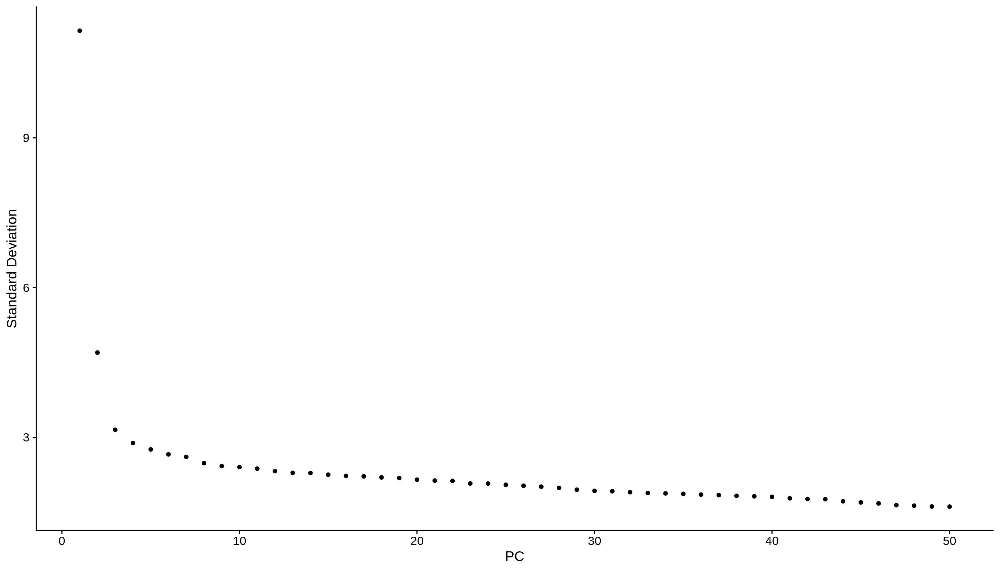

In [127]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [128]:
pcDim = 10

In [129]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)

16:17:49 UMAP embedding parameters a = 0.9922 b = 1.112

16:17:49 Read 14192 rows and found 10 numeric columns

16:17:49 Using Annoy for neighbor search, n_neighbors = 30

16:17:49 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:17:51 Writing NN index file to temp file /tmp/RtmpAbE7Wn/file16bc6f6e61c81

16:17:51 Searching Annoy index using 1 thread, search_k = 3000

16:17:55 Annoy recall = 100%

16:17:56 Commencing smooth kNN distance calibration using 1 thread

16:17:57 Initializing from normalized Laplacian + noise

16:17:57 Commencing optimization for 200 epochs, with 558696 positive edges

16:18:02 Optimization finished



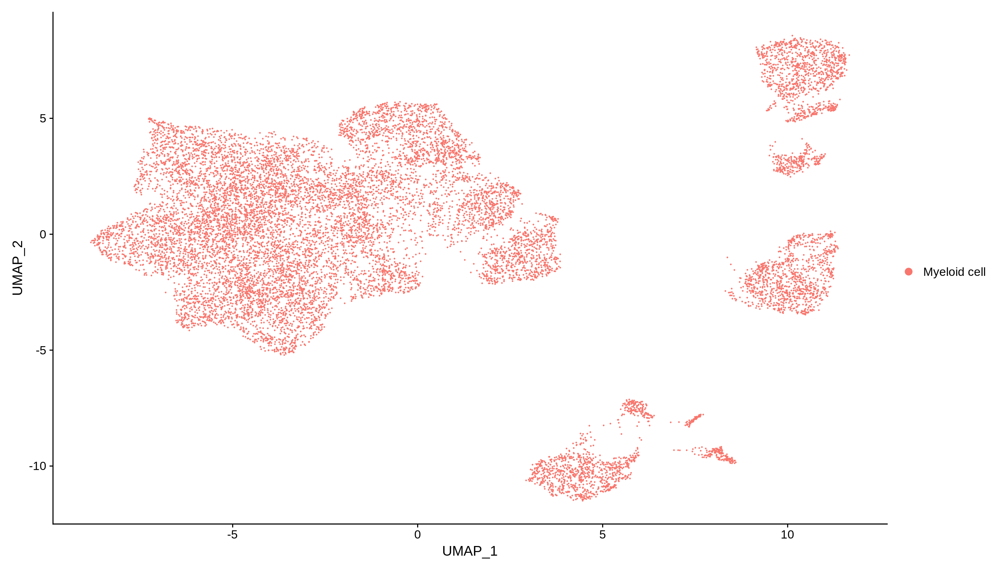

In [130]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

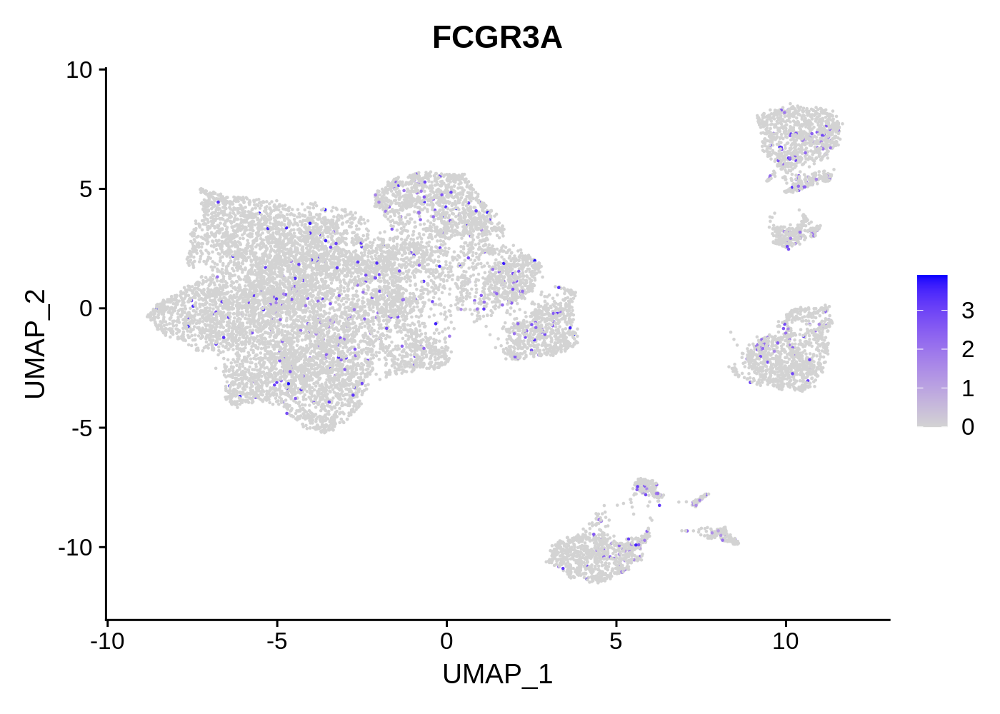

In [131]:
options(repr.plot.width=7, repr.plot.height=5*1, repr.plot.res = 200)
FeaturePlot(subobj,c("FCGR3A"))

Warning message in FeaturePlot(subobj, c("PLAC8", "MSR1", "MRC1")):
“All cells have the same value (0) of PLAC8.”


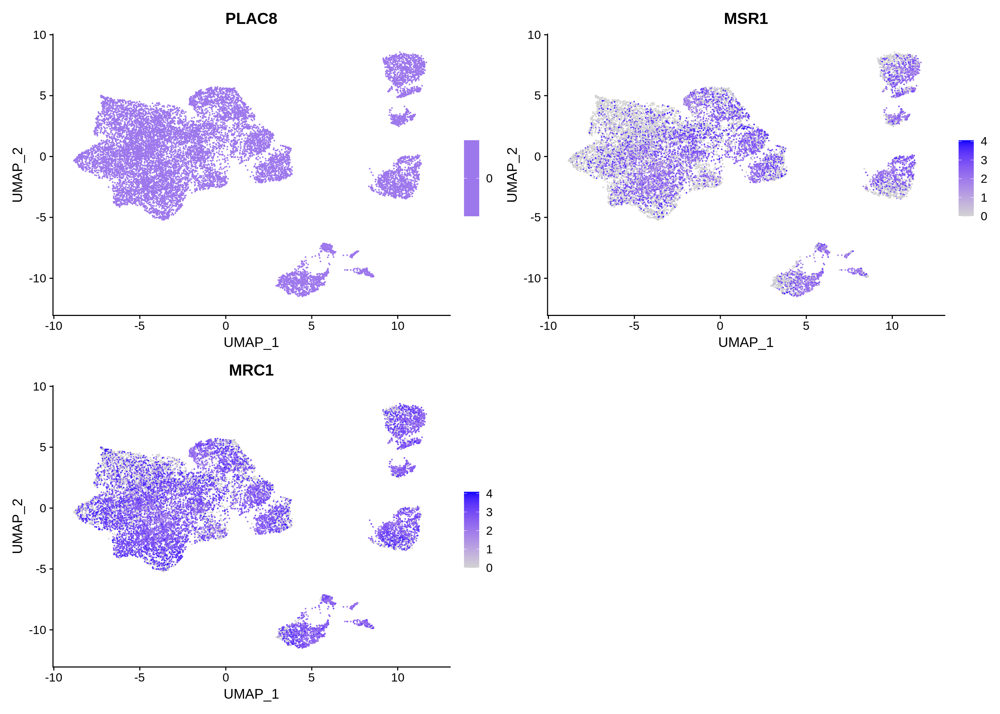

In [132]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PLAC8","MSR1","MRC1"))

### Reannotate Lymphoid cell

In [133]:
subobj <- subset(dataobj,cell_type =="Lymphoid cell")

In [134]:
subobj <- FindVariableFeatures(subobj)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”


Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 1757 features requested have not been scaled (running reduction without them): HHIPL1, LINC01231, MS4A14, PUSL1, FAM71E1, C6orf47-AS1, COLEC11, DYDC1, NR2F6, CNOT6L, ERICH6, CCL25, LRRC38, MRPL37, TBC1D29P, ZNF792, PRR25, MAFF, SAXO1, LINC01111, CLRN2, ENTPD3, SYT7, DMPK, GYPB, LINC00837, CHTF18, NRIR, HAPLN1, GGCT, GSEC, PPP1R26-AS1, SLC29A2, EFEMP2, RTN4RL2, SCN5A, GMPPA, KCNK2, NIPSNAP3A, HNRNPA0, TSNAXIP1, ACOXL, PGAM5, CHODL-AS1, ACP3, MRPL44, SMCHD1, AOAH, ALPL, ADAMTS5, CBLB, PDE6A, H1-0, NIBAN3, ANKRD24, S100A12, TMEM150B, RHPN1, ESCO2, TBX1, PPP1R3D, ITIH6, SMIM2-AS1, TMEM14A, RRAD, TGIF2-RAB5IF, GPT2, RHEBL1, MORC1-AS1, CDC42SE2, SYN2, PYY, HCG9, ERICH3, COLCA2, CD96, P4HA2-AS1, PPP1R3C, PHYHD1, CRIPT, ZNF724, PPP2R5C, PTCD2, INHA, HDHD5-AS1, TMEM167B, PLA1A, FAM189B, TMEM211, OTOA, ATXN1, PCYT2, EPGN, SLC5A1, IRAG1-AS1, CNTN3, NEAT1, SMIM27, ERICH6-AS1, RFPL3S, VTI1B, COPZ2, CL

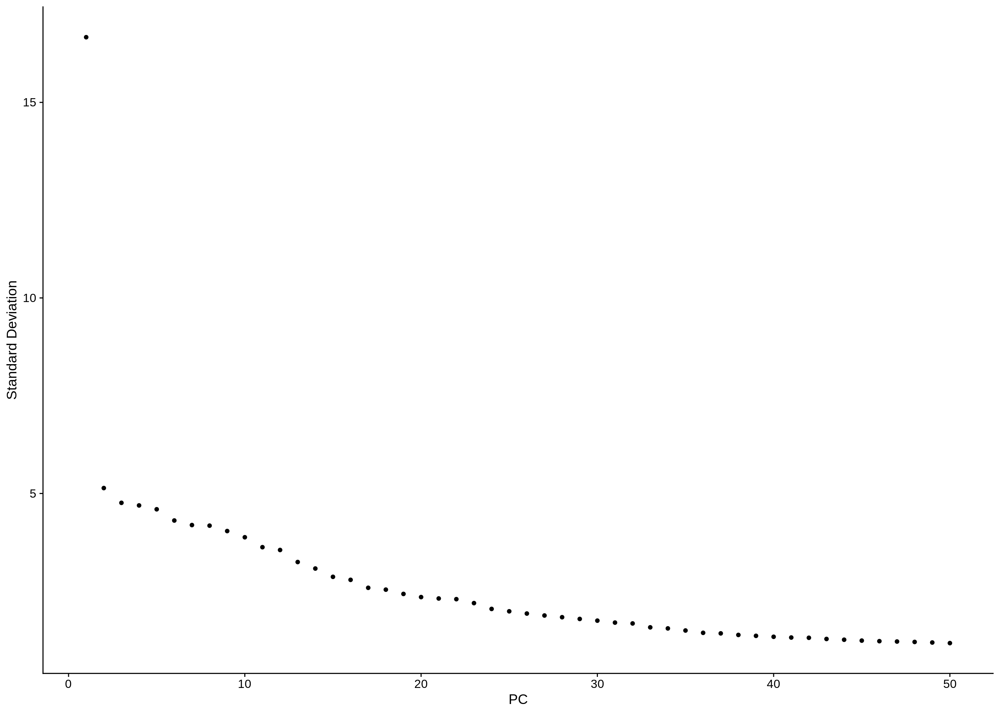

In [135]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [136]:
pcDim = 30

In [137]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

16:19:31 UMAP embedding parameters a = 0.9922 b = 1.112

16:19:31 Read 1077 rows and found 30 numeric columns

16:19:31 Using Annoy for neighbor search, n_neighbors = 30

16:19:31 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:19:31 Writing NN index file to temp file /tmp/RtmpAbE7Wn/file16bc6f6f13ae63

16:19:31 Searching Annoy index using 1 thread, search_k = 3000

16:19:31 Annoy recall = 100%

16:19:32 Commencing smooth kNN distance calibration using 1 thread

16:19:32 Initializing from normalized Laplacian + noise

16:19:32 Commencing optimization for 500 epochs, with 46648 positive edges

16:19:33 Optimization finished



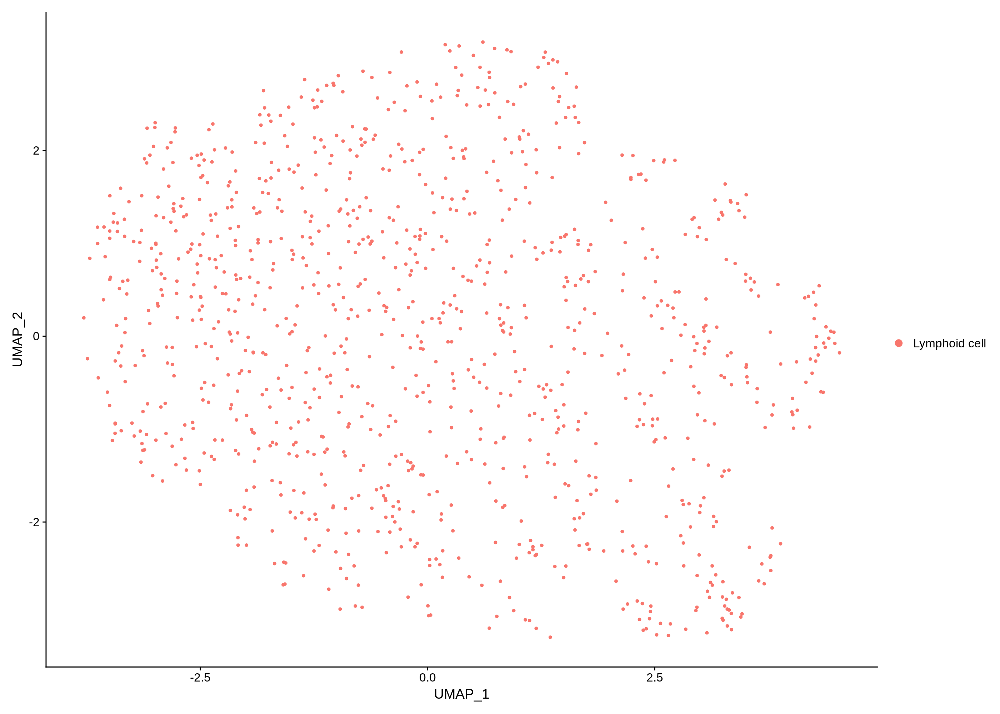

In [138]:
DimPlot(subobj, reduction = "umap")

In [139]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.2, n.start = 2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1077
Number of edges: 39491

Running Louvain algorithm...
Maximum modularity in 2 random starts: 0.8388
Number of communities: 3
Elapsed time: 0 seconds


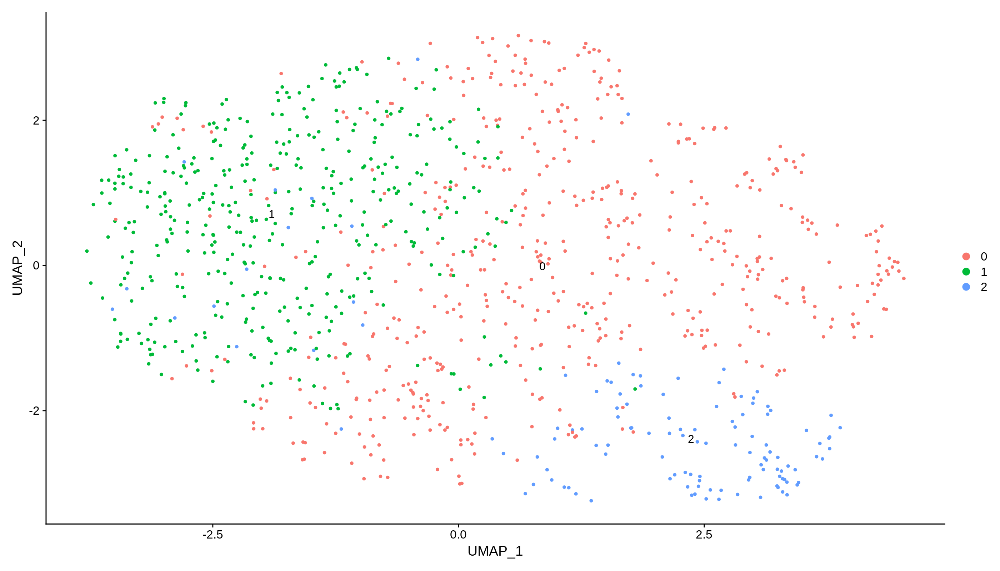

In [140]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

### B cell

Warning message in FeaturePlot(subobj, c("CD79A", "CD24")):
“All cells have the same value (0) of CD79A.”
Warning message in FeaturePlot(subobj, c("CD79A", "CD24")):
“All cells have the same value (0) of CD24.”


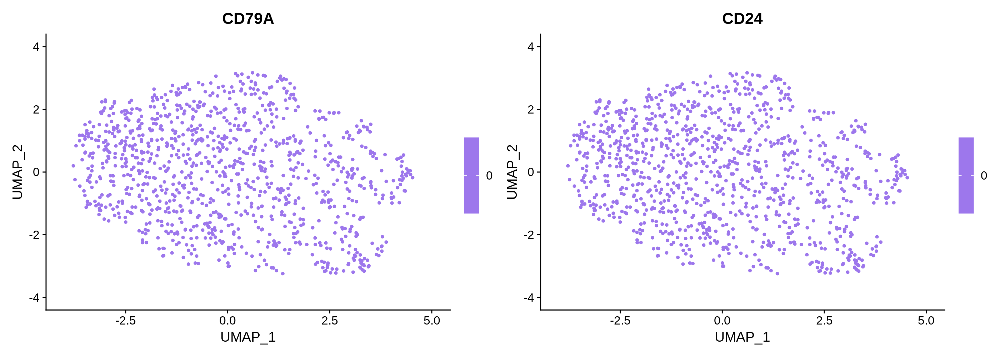

In [141]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CD79A","CD24"))

### T cell

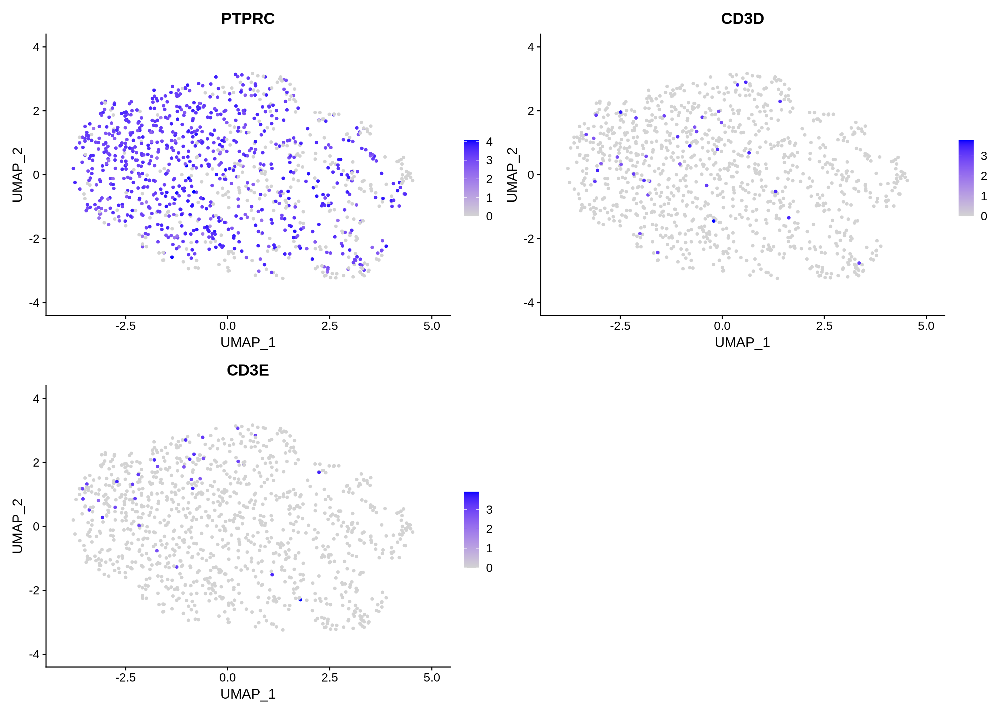

In [142]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PTPRC","CD3D","CD3E"))

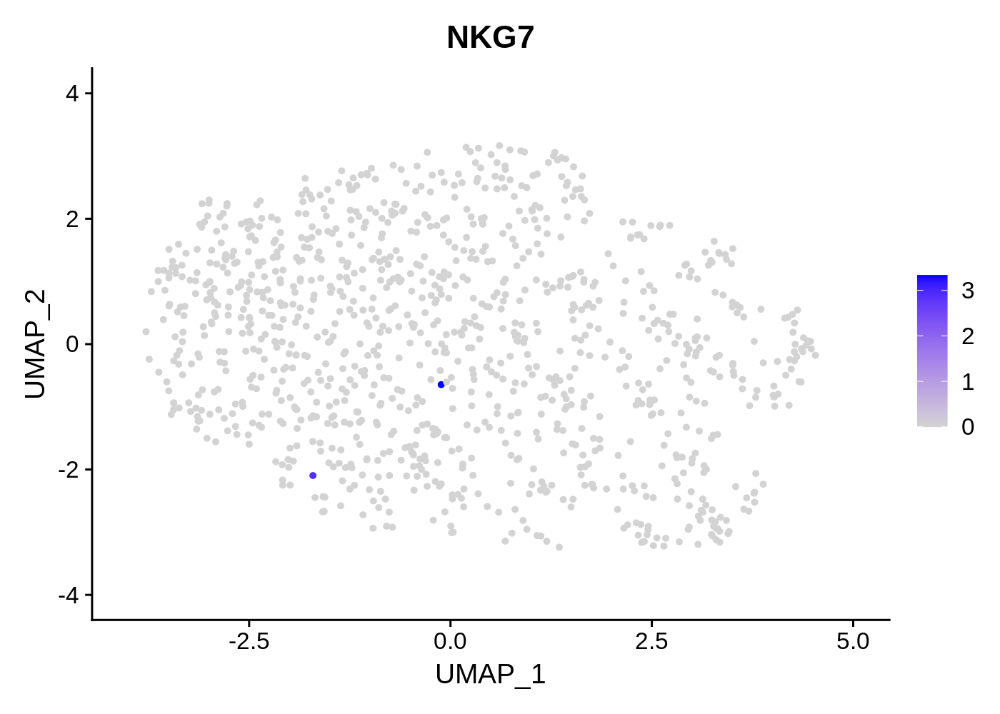

In [143]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("NKG7"))

In [145]:
subobj <- RenameIdents(object = subobj,'0' = 'Lymphoid','1' = 'Lymphoid','2' = 'Lymphoid')

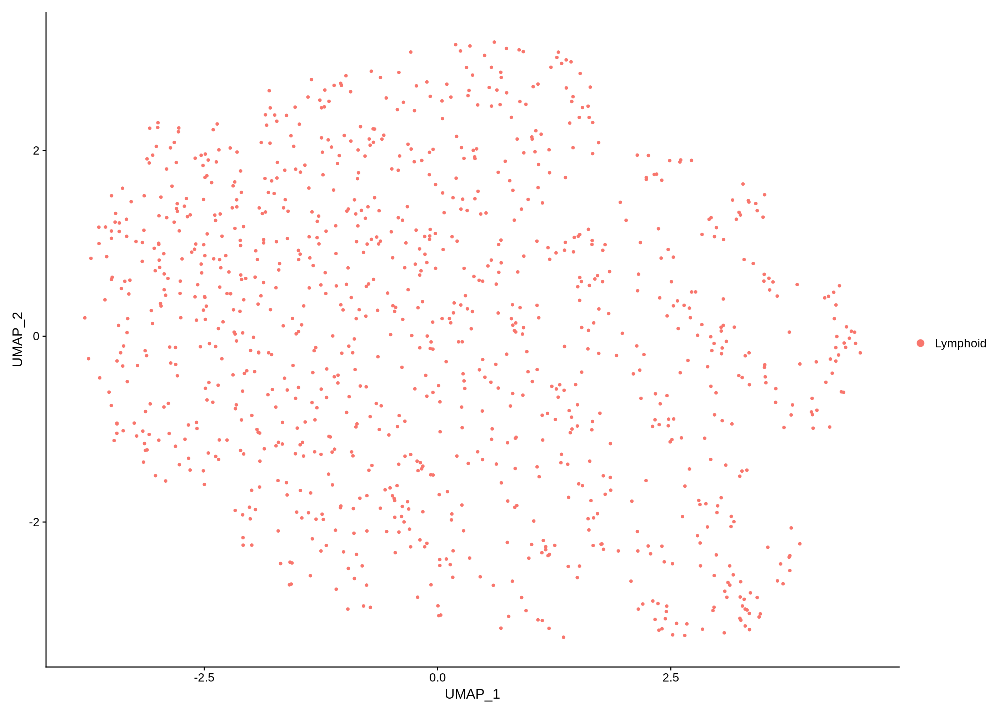

In [146]:
DimPlot(subobj)

In [147]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

# Recheck all

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



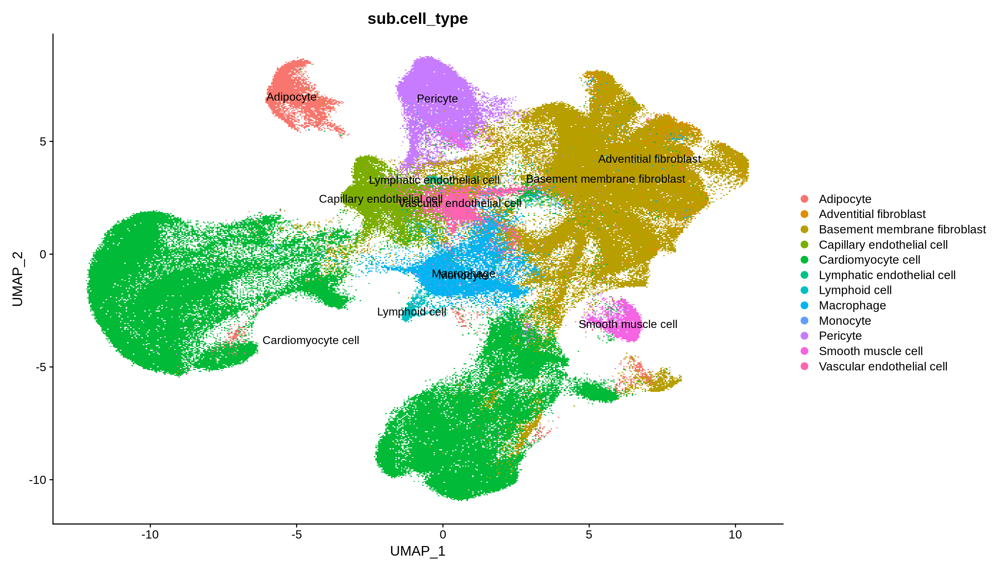

In [37]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",group.by = "sub.cell_type",label = T)

# reorganize metadata

In [38]:
colnames(dataobj@meta.data)

[1] "study_doi"           "barcode"             "structural unit"    
 [4] "sub structural unit" "seq_tech"            "development_stage"  
 [7] "donor_id"            "donor_gender"        "donor_age"          
[10] "cell_type"           "sub.cell_type"

In [39]:
dataobj@meta.data <- dataobj@meta.data[,c('study_doi','barcode','structural unit','sub structural unit','seq_tech','development_stage','donor_id','donor_gender','donor_age','cell_type','sub.cell_type')]

In [40]:
saveRDS(dataobj,"/data1/chenyx/Compitition/processed/Tucker.rds")

# reorganize metadata for database

In [4]:
dataobj <- readRDS("/data1/chenyx/Compitition/processed/Tucker.rds")

In [5]:
dataobj

An object of class Seurat 
43878 features across 262003 samples within 1 assay 
Active assay: RNA (43878 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [7]:
colnames(dataobj@meta.data) <- c("Ref","cell_ID","region","subregion","seq_tech","develop_stage","donor_ID","donor_gender","donor_age","MCT","cell_type")

In [8]:
dataobj@meta.data$organ <- "Heart"
dataobj@meta.data$sample_status <- "Healthy"
dataobj@meta.data$donor_status <- "Healthy"
dataobj@meta.data$seq_tech <- "10X"
dataobj@meta.data$treatment <- "None"
dataobj@meta.data$ethnicity <- "NA"
dataobj@meta.data$if_patient <- "No"

In [9]:
dataobj@meta.data

,Ref,cell_ID,region,subregion,seq_tech,develop_stage,donor_ID,donor_gender,donor_age,MCT,cell_type,organ,sample_status,donor_status,treatment,ethnicity,if_patient
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
LA_1600_1_TACTTACTCCTCTAGC,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_TACTTACTCCTCTAGC,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_GGCGTGTAGGAGTTGC,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_GGCGTGTAGGAGTTGC,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_ACGCCGACATCGGTTA,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_ACGCCGACATCGGTTA,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_ACCCACTGTCGGCACT,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_ACCCACTGTCGGCACT,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_CCTTTCTTCCGCGGTA,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_CCTTTCTTCCGCGGTA,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_GACTGCGGTGGTTTCA,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_GACTGCGGTGGTTTCA,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_CATATTCAGGAGTTGC,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_CATATTCAGGAGTTGC,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Adipocyte,Adipocyte,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_CCTTTCTAGAAACCAT,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_CCTTTCTAGAAACCAT,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No
LA_1600_1_TGCCAAATCACCCTCA,10.1161/CIRCULATIONAHA.119.045401,LA_1600_1_TGCCAAATCACCCTCA,Atria,Left atria,10X,Adult,Tucker2020 1600,Female,51yr,Cardiomyocyte cell,Cardiomyocyte cell,Heart,Healthy,Healthy,None,NA,No


In [10]:
saveRDS(dataobj,"/data1/chenyx/Compitition/processed/Tucker.rds")